In [12]:
from pytorch_lightning.callbacks import ModelCheckpoint
from pytorch_lightning.loggers import TensorBoardLogger
import torchvision


from Dataset.dataset import KneeDataset
from Models.Model1_UNET2017 import UNet
from pathlib import Path


from torch.utils.tensorboard import SummaryWriter

import matplotlib.pyplot as plt
import torch
import numpy as np
import pytorch_lightning as pl

from Models.SuperResolution import SuperResolutionModel

from torchmetrics.image import StructuralSimilarityIndexMeasure as ssim
from torchmetrics.image import PeakSignalNoiseRatio as psnr

In [3]:
torch.set_float32_matmul_precision("medium")
writer = SummaryWriter('logs/MultiCoil4Folds/UNET1_TransferLearning_BZ_32_LR_2e-4_Deco4')

In [4]:
train_path = Path('C:/Users/garci/PycharmProjects/FastTakitoMulticoil/PreprocessedMC4fold/multicoil_train')
val_path = Path('C:/Users/garci/PycharmProjects/FastTakitoMulticoil/PreprocessedMC4fold/multicoil_val')

train_dataset = KneeDataset(train_path)
val_dataset = KneeDataset(val_path)

In [5]:
train_dataset.__len__()

34742

In [6]:
HR,LR= train_dataset.__getitem__(555)
print(HR.shape,LR.shape)
print(HR.max(),HR.min(),LR.max(),LR.min())

(1, 320, 320) (1, 320, 320)
1.0 0.0 1.0 0.0


Text(0.5, 1.0, 'Low Resolution')

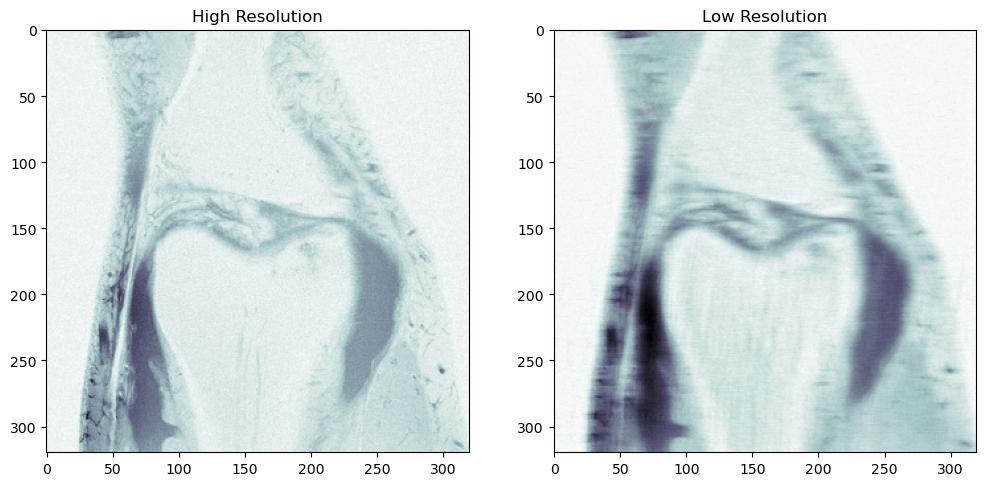

In [7]:
fig, ax = plt.subplots(1, 2, figsize=(12, 12))
ax[0].imshow(HR[0], cmap="bone_r")
ax[0].set_title("High Resolution")
ax[1].imshow(LR[0], cmap="bone_r")
ax[1].set_title("Low Resolution")

In [8]:
batch_size = 32
num_workers = 8

train_loader = torch.utils.data.DataLoader(train_dataset,
                                           batch_size=batch_size,
                                           shuffle=True,
                                           num_workers=num_workers,
                                           drop_last=True)

val_loader = torch.utils.data.DataLoader(val_dataset,
                                         batch_size=batch_size,
                                         shuffle=False,
                                         num_workers=num_workers,
                                         drop_last=True)

In [9]:
train_loader.dataset.__len__(), val_loader.dataset.__len__()

(34742, 7135)

In [10]:
hr, lr = next(iter(train_loader))
print(hr.shape, lr.shape)

torch.Size([32, 1, 320, 320]) torch.Size([32, 1, 320, 320])


In [11]:
img_grid_lr = torchvision.utils.make_grid(lr)
writer.add_image('Low Resolution', img_grid_lr)
writer.close()
img_grid_hr = torchvision.utils.make_grid(hr)
writer.add_image('High Resolution', img_grid_hr)
writer.close()

In [13]:
# Instanciate the model and set the random seed
torch.manual_seed(0)
model = SuperResolutionModel.load_from_checkpoint(
    r'C:\Users\garci\PycharmProjects\FastTakito\logs\Model1_UNET2017_Basico\UNET1_BZ_32_LR_2e-4_Deco4\lightning_logs\version_0\checkpoints\epoch=21-step=23870.ckpt'
)

In [14]:
from torchinfo import summary
summary(model = model,
        input_size = (8,1,320,320),
        col_names = ["input_size", "output_size", "num_params", "trainable"],
        col_width = 20,
        row_settings = ["var_names"])

Layer (type (var_name))                       Input Shape          Output Shape         Param #              Trainable
SuperResolutionModel (SuperResolutionModel)   [8, 1, 320, 320]     [8, 1, 320, 320]     --                   True
├─UNet (model)                                [8, 1, 320, 320]     [8, 1, 320, 320]     --                   True
│    └─Sequential (e1)                        [8, 1, 320, 320]     [8, 64, 320, 320]    --                   True
│    │    └─ConvBlock (0)                     [8, 1, 320, 320]     [8, 64, 320, 320]    768                  True
│    │    └─ConvBlock (1)                     [8, 64, 320, 320]    [8, 64, 320, 320]    37,056               True
│    └─MaxPool2d (maxpool1)                   [8, 64, 320, 320]    [8, 64, 160, 160]    --                   --
│    └─Sequential (e2)                        [8, 64, 160, 160]    [8, 128, 160, 160]   --                   True
│    │    └─ConvBlock (0)                     [8, 64, 160, 160]    [8, 128, 160, 160]

In [15]:
# Freeze layers e1 to e4
for layer in [model.model.e1, model.model.e2, model.model.e3, model.model.e4]:
    for param in layer.parameters():
        param.requires_grad = False

In [16]:
from torchinfo import summary
summary(model = model,
        input_size = (8,1,320,320),
        col_names = ["input_size", "output_size", "num_params", "trainable"],
        col_width = 20,
        row_settings = ["var_names"])

Layer (type (var_name))                       Input Shape          Output Shape         Param #              Trainable
SuperResolutionModel (SuperResolutionModel)   [8, 1, 320, 320]     [8, 1, 320, 320]     --                   Partial
├─UNet (model)                                [8, 1, 320, 320]     [8, 1, 320, 320]     --                   Partial
│    └─Sequential (e1)                        [8, 1, 320, 320]     [8, 64, 320, 320]    --                   False
│    │    └─ConvBlock (0)                     [8, 1, 320, 320]     [8, 64, 320, 320]    (768)                False
│    │    └─ConvBlock (1)                     [8, 64, 320, 320]    [8, 64, 320, 320]    (37,056)             False
│    └─MaxPool2d (maxpool1)                   [8, 64, 320, 320]    [8, 64, 160, 160]    --                   --
│    └─Sequential (e2)                        [8, 64, 160, 160]    [8, 128, 160, 160]   --                   False
│    │    └─ConvBlock (0)                     [8, 64, 160, 160]    [8, 128,

In [17]:
# Create the checkpoint callback
checkpoint_callback = ModelCheckpoint(
    monitor='Val loss MSE',
    save_top_k=3,
    mode='min')

In [18]:
accelerator = "cuda"
trainer = pl.Trainer(accelerator, logger=TensorBoardLogger(save_dir="logs/MultiCoil4Folds/UNET1_TransferLearning_BZ_32_LR_2e-4_Deco4"), log_every_n_steps=1, callbacks=checkpoint_callback, max_epochs=40, precision="16-mixed")

Using 16bit Automatic Mixed Precision (AMP)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [19]:
torch.cuda.empty_cache()

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name       | Type                             | Params | Mode 
------------------------------------------------------------------------
0 | model      | UNet                             | 15.8 M | train
1 | loss_fn    | MSELoss                          | 0      | train
2 | train_ssim | StructuralSimilarityIndexMeasure | 0      | train
3 | val_ssim   | StructuralSimilarityIndexMeasure | 0      | train
4 | train_psnr | PeakSignalNoiseRatio             | 0      | train
5 | val_psnr   | PeakSignalNoiseRatio             | 0      | train
------------------------------------------------------------------------
11.1 M    Trainable params
4.7 M     Non-trainable params
15.8 M    Total params
63.327    Total estimated model params size (MB)
107       Modules in train mode
0         Modules in eval mode


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

C:\Users\garci\anaconda3\envs\FastTakito\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:419: Consider setting `persistent_workers=True` in 'val_dataloader' to speed up the dataloader worker initialization.


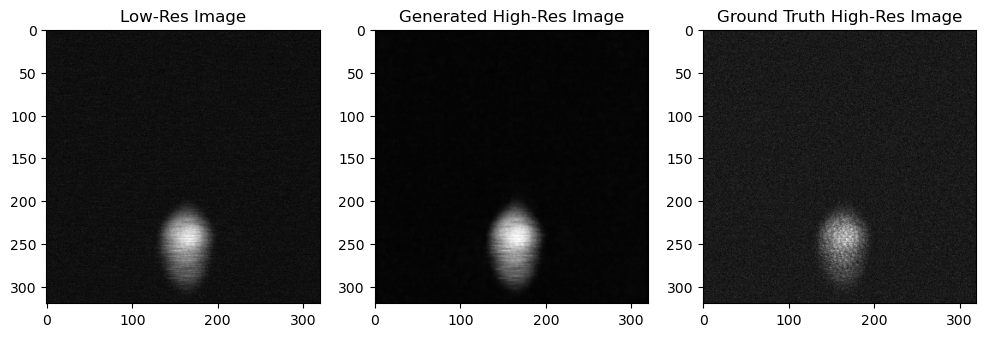

C:\Users\garci\anaconda3\envs\FastTakito\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:419: Consider setting `persistent_workers=True` in 'train_dataloader' to speed up the dataloader worker initialization.


Training: |          | 0/? [00:00<?, ?it/s]

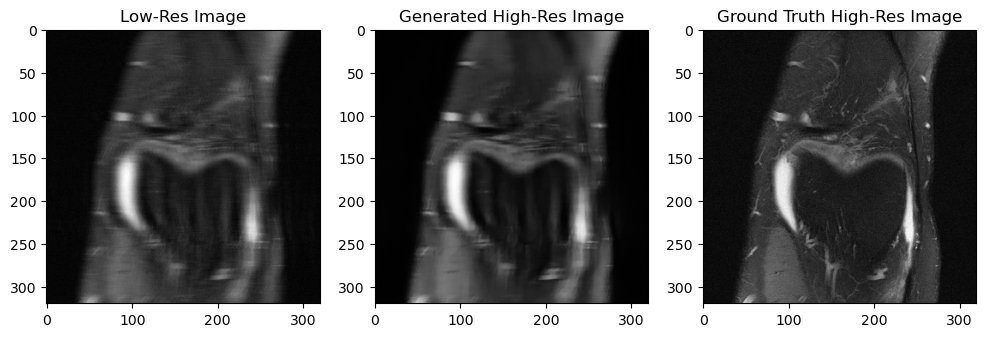

Validation: |          | 0/? [00:00<?, ?it/s]

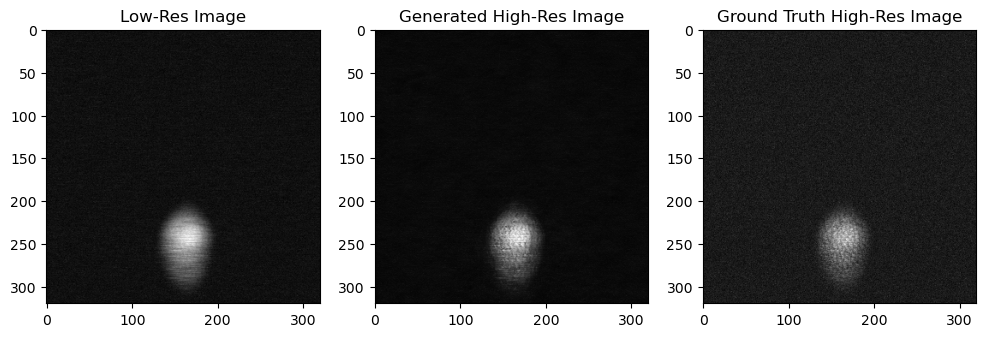

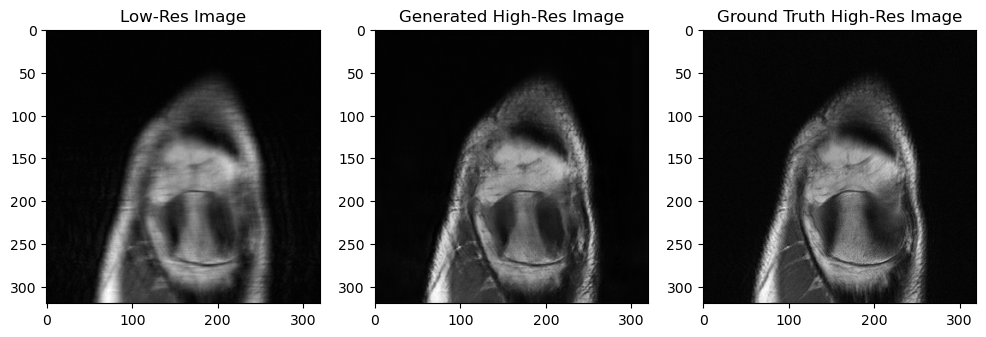

Validation: |          | 0/? [00:00<?, ?it/s]

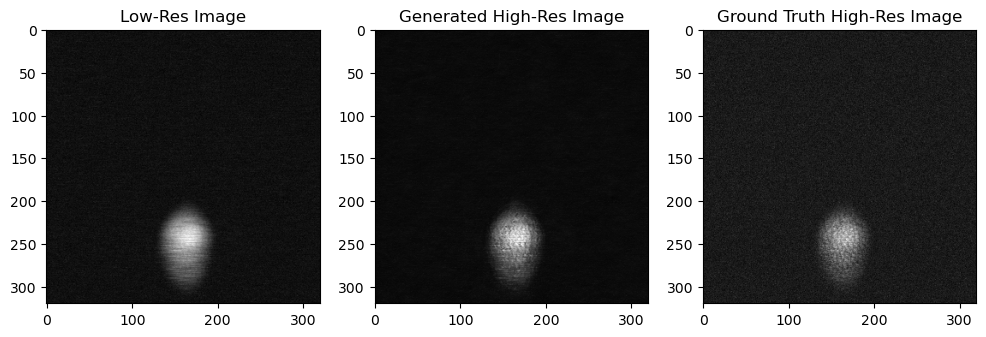

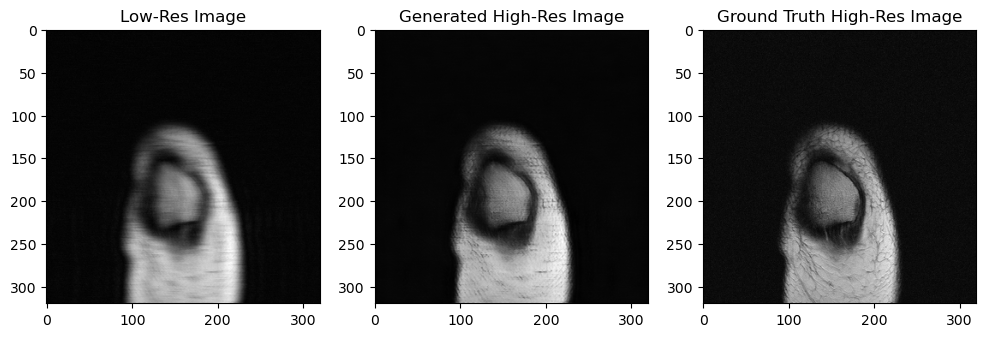

Validation: |          | 0/? [00:00<?, ?it/s]

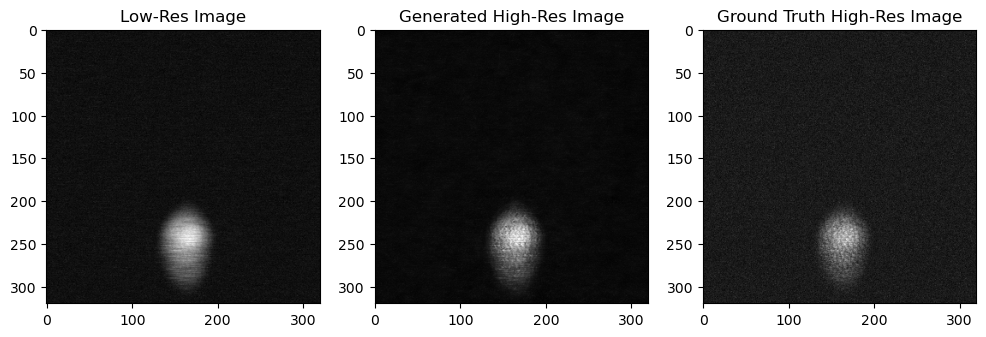

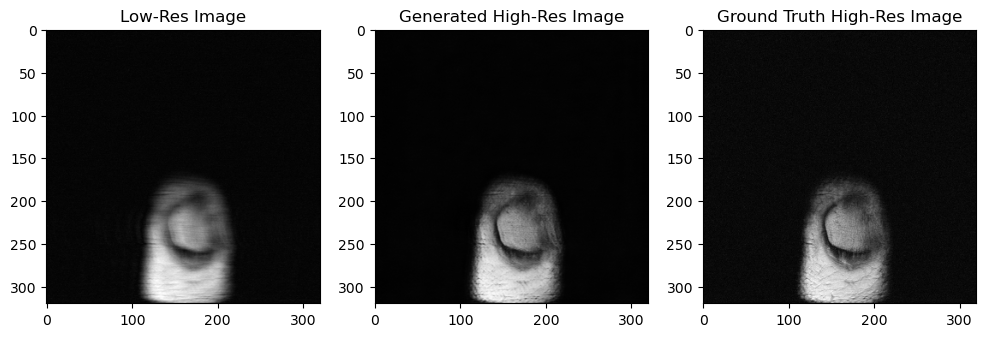

Validation: |          | 0/? [00:00<?, ?it/s]

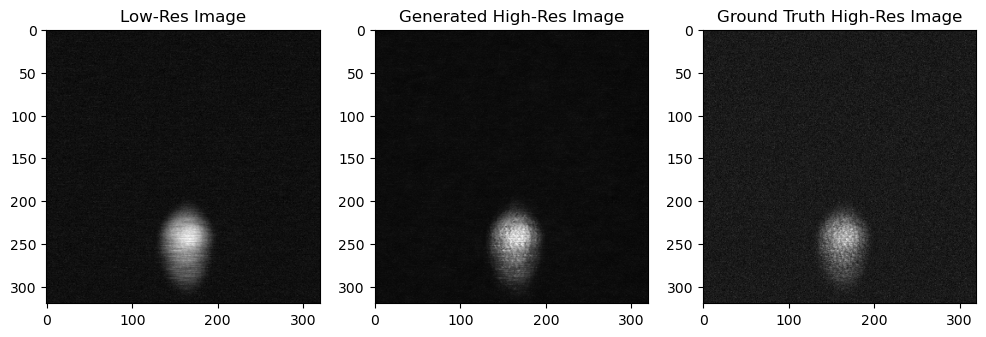

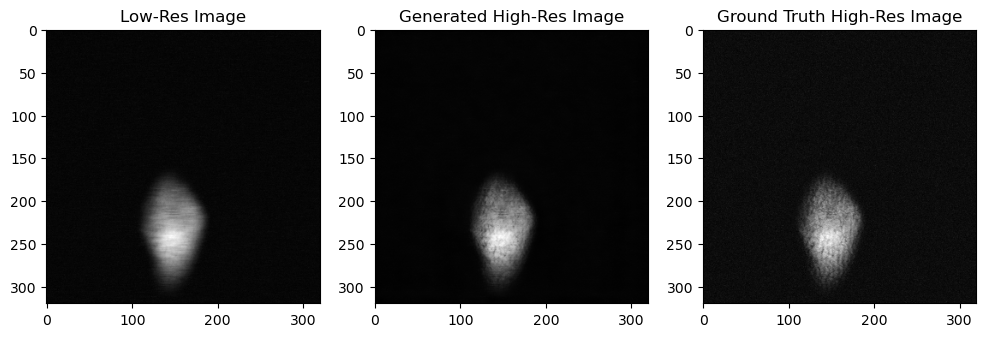

Validation: |          | 0/? [00:00<?, ?it/s]

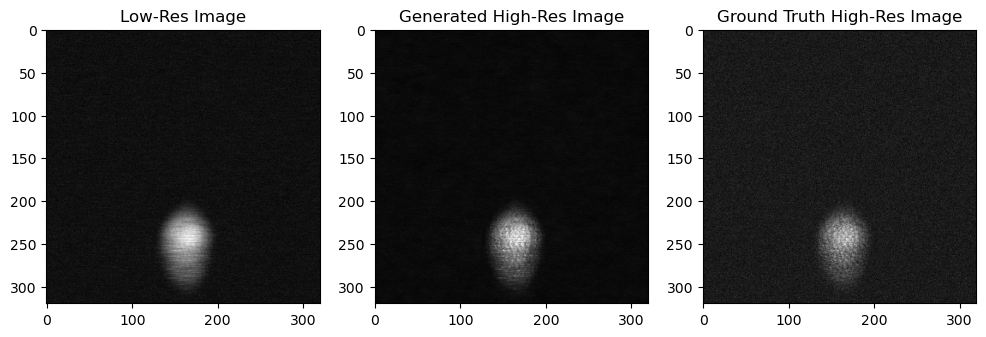

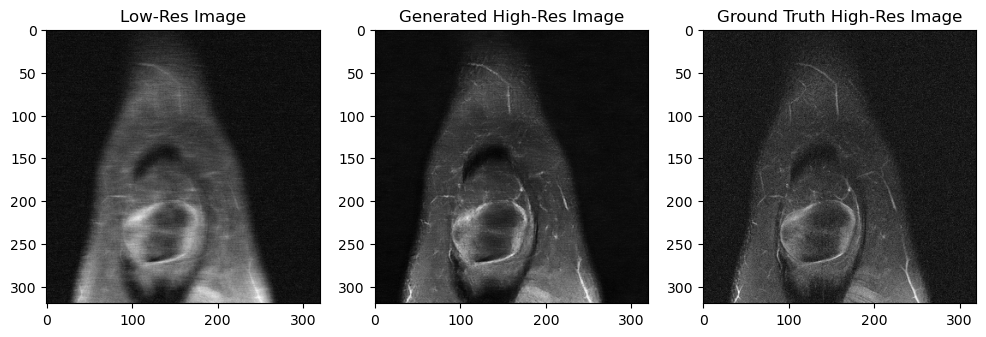

Validation: |          | 0/? [00:00<?, ?it/s]

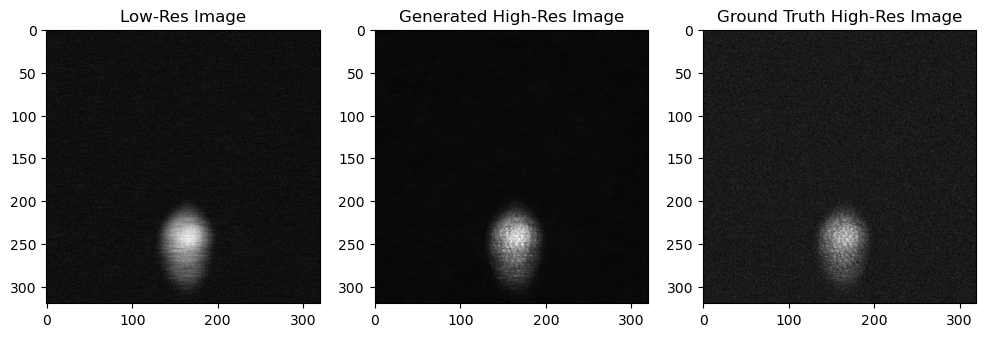

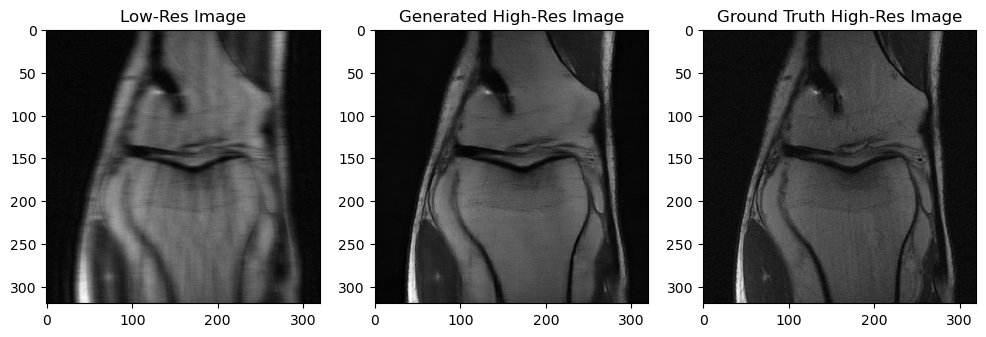

Validation: |          | 0/? [00:00<?, ?it/s]

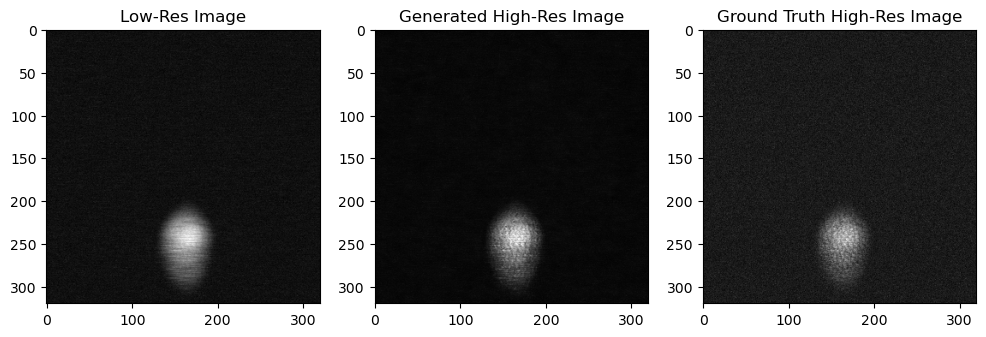

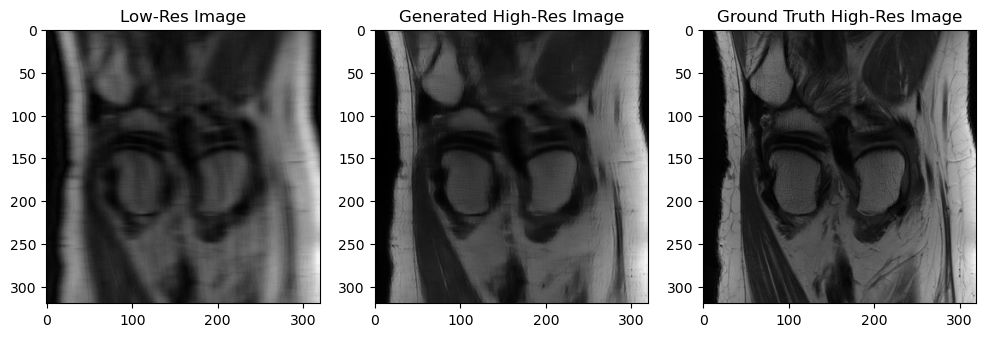

Validation: |          | 0/? [00:00<?, ?it/s]

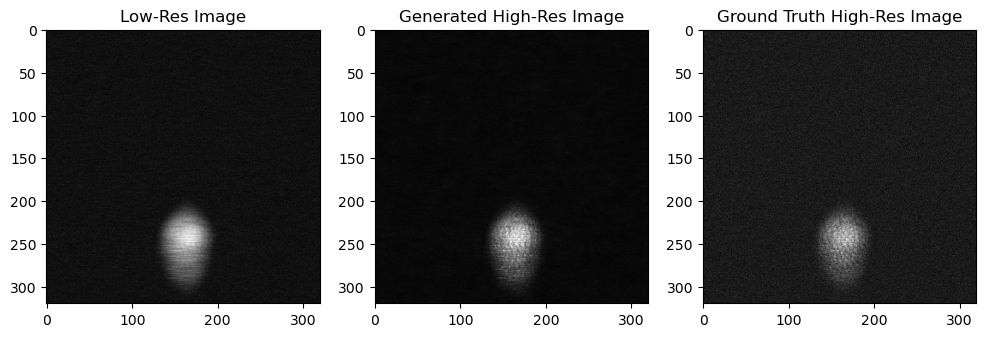

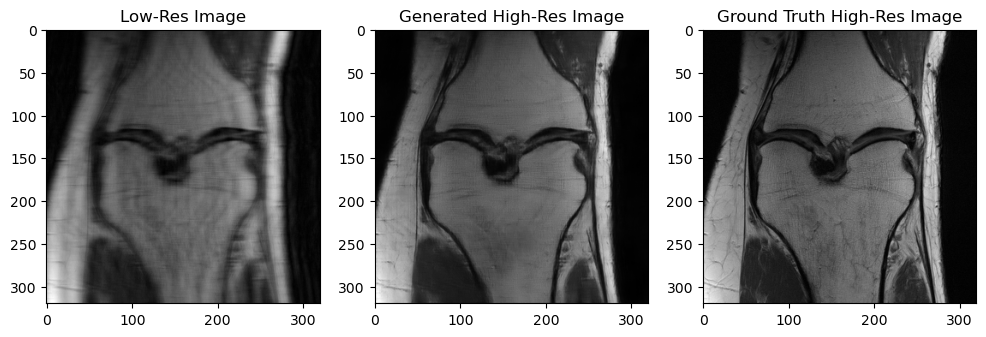

Validation: |          | 0/? [00:00<?, ?it/s]

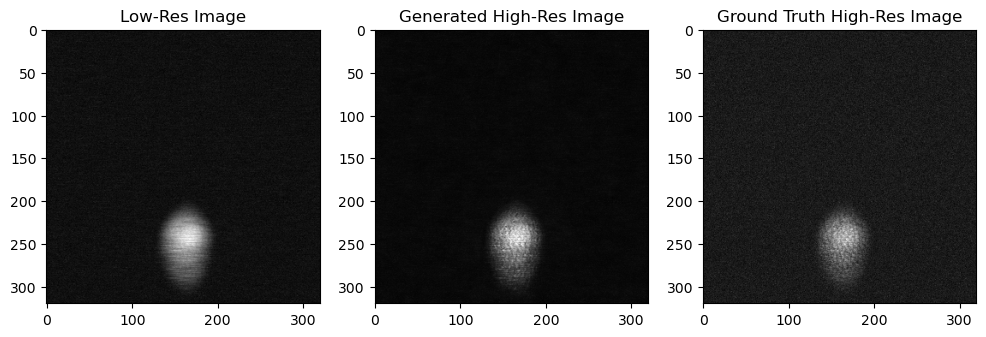

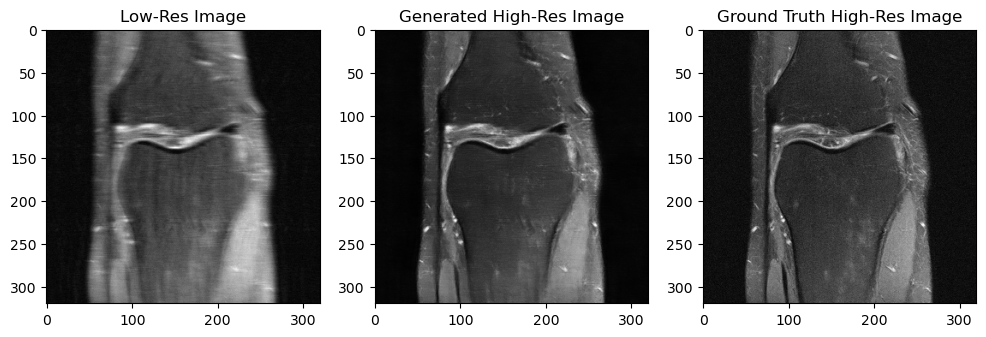

Validation: |          | 0/? [00:00<?, ?it/s]

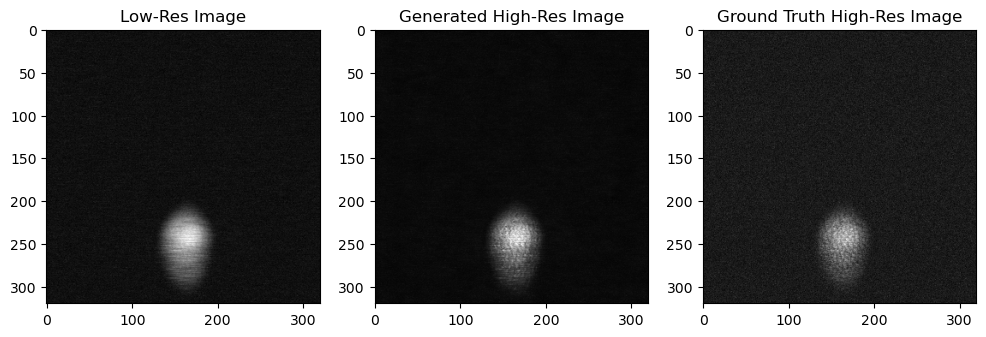

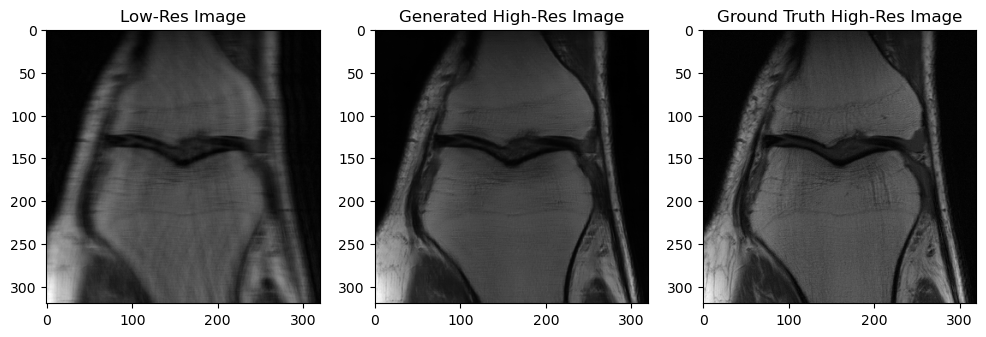

Validation: |          | 0/? [00:00<?, ?it/s]

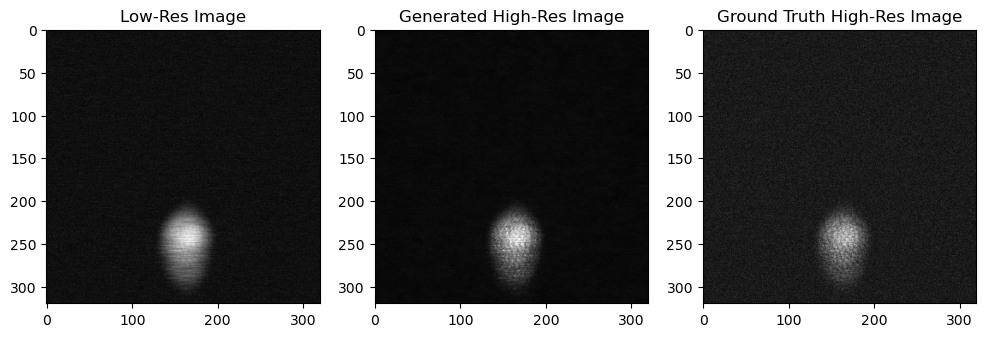

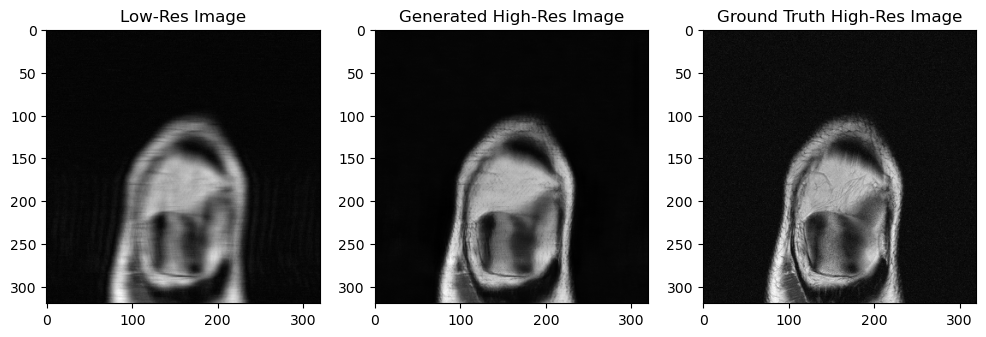

Validation: |          | 0/? [00:00<?, ?it/s]

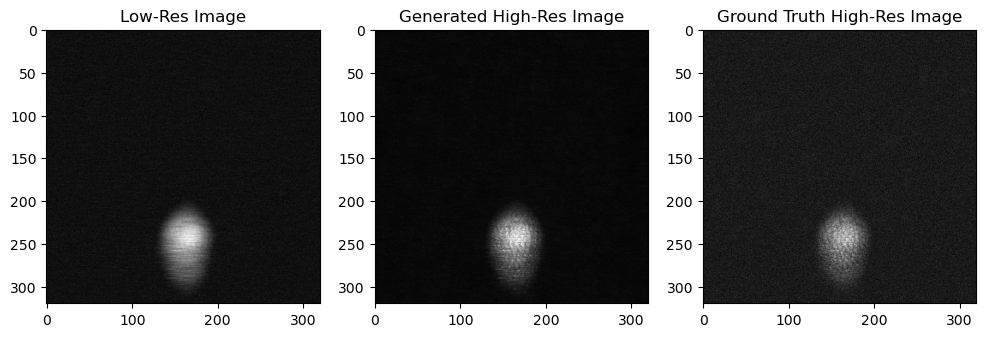

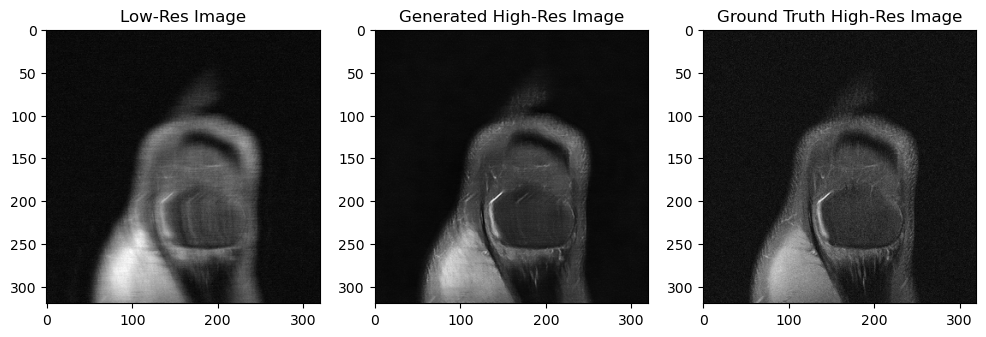

Validation: |          | 0/? [00:00<?, ?it/s]

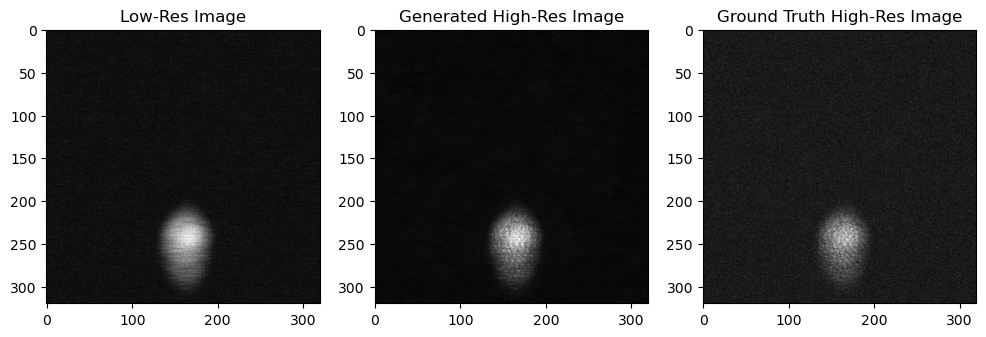

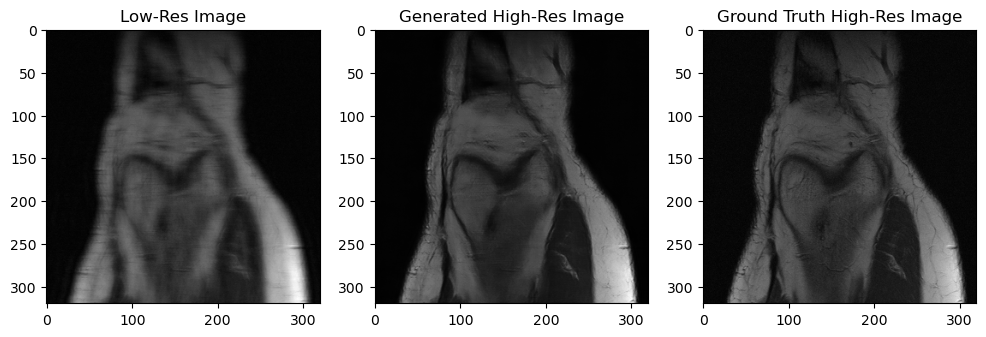

Validation: |          | 0/? [00:00<?, ?it/s]

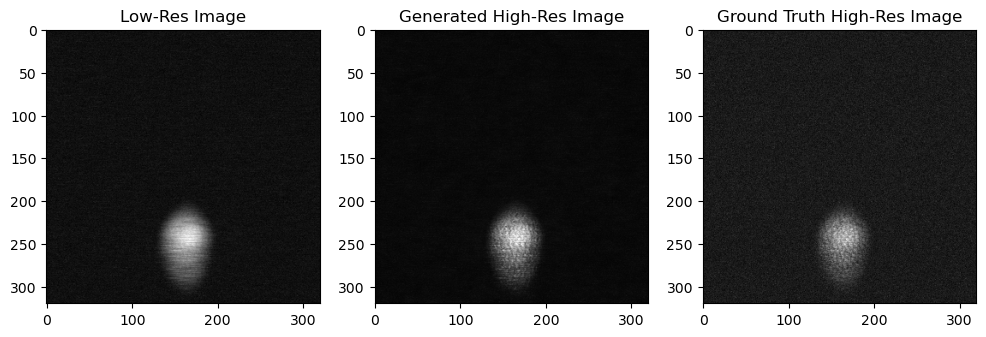

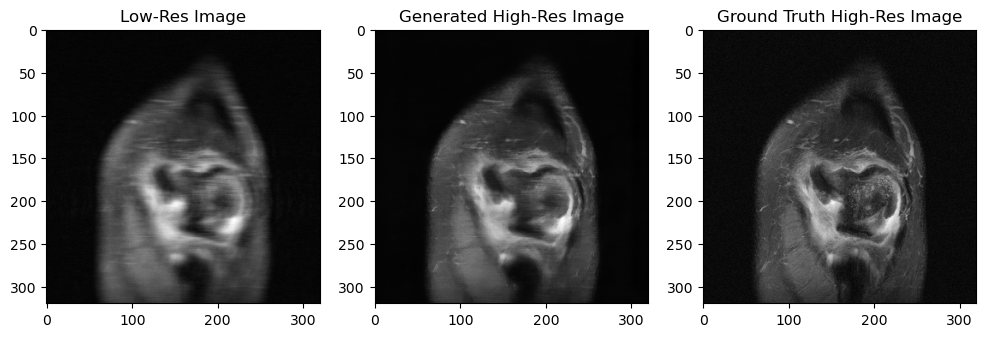

Validation: |          | 0/? [00:00<?, ?it/s]

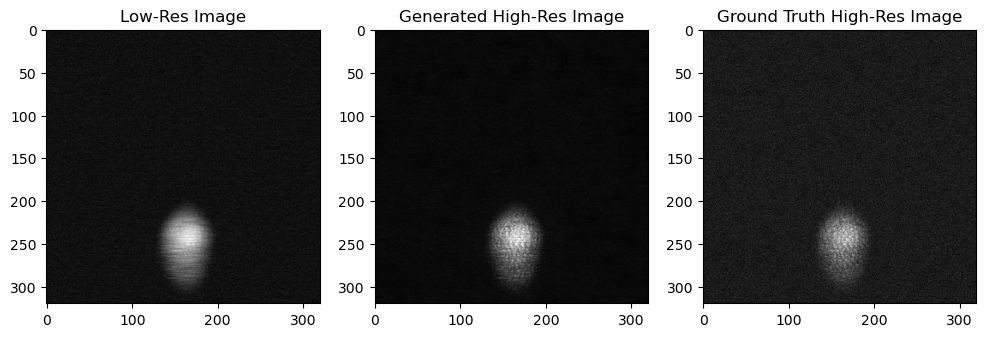

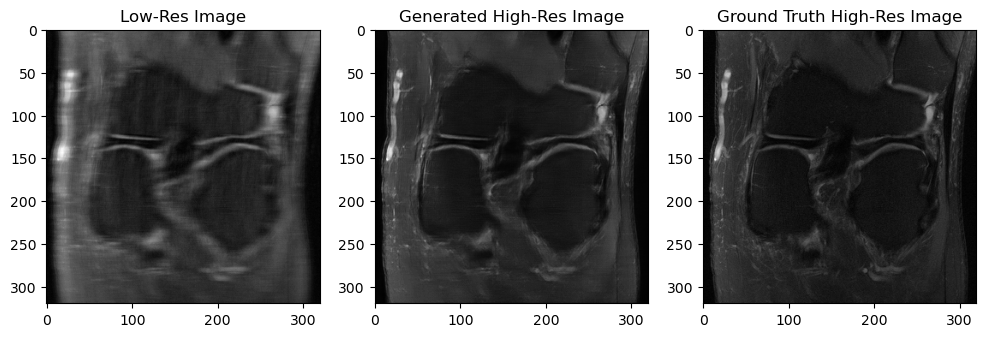

Validation: |          | 0/? [00:00<?, ?it/s]

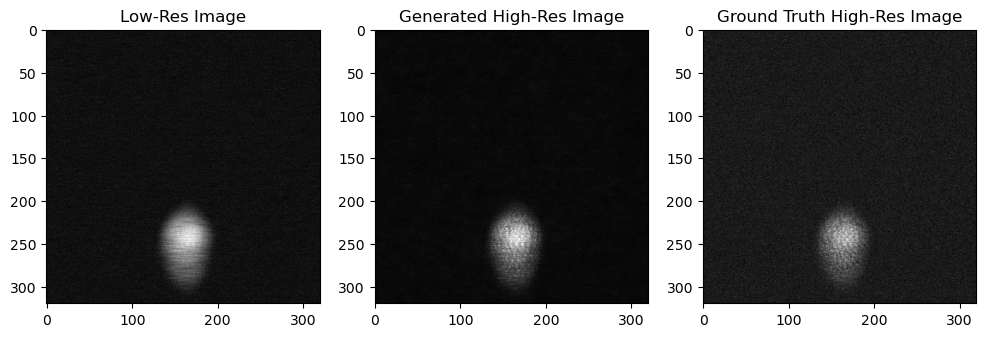

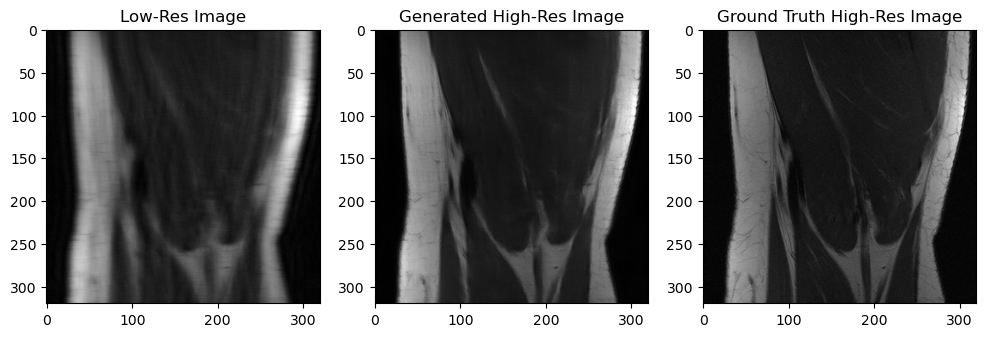

Validation: |          | 0/? [00:00<?, ?it/s]

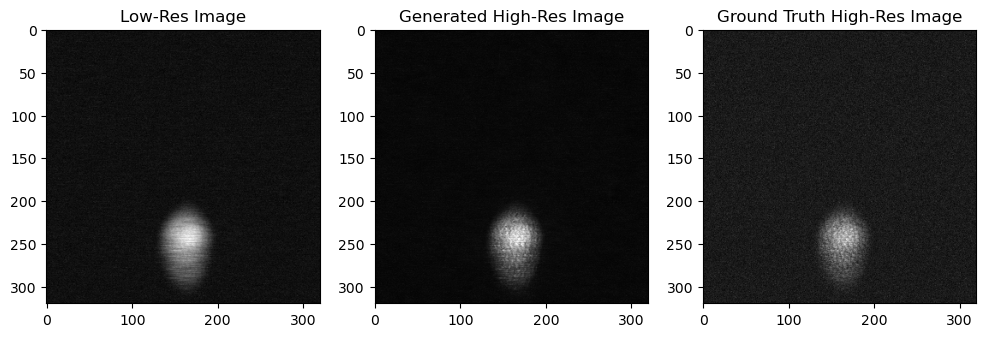

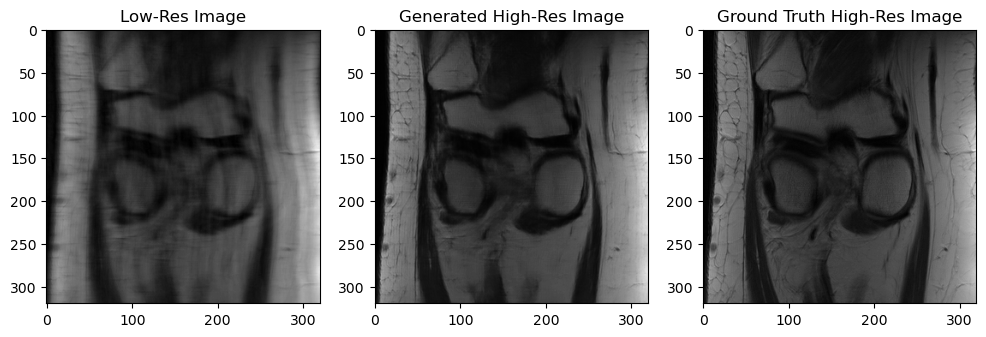

Validation: |          | 0/? [00:00<?, ?it/s]

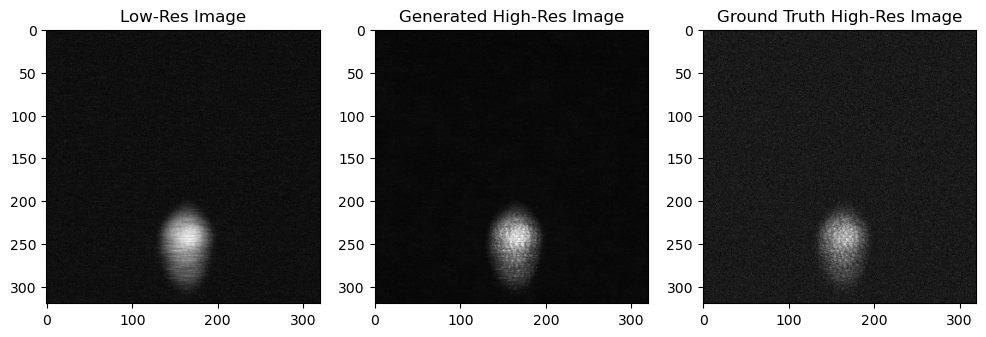

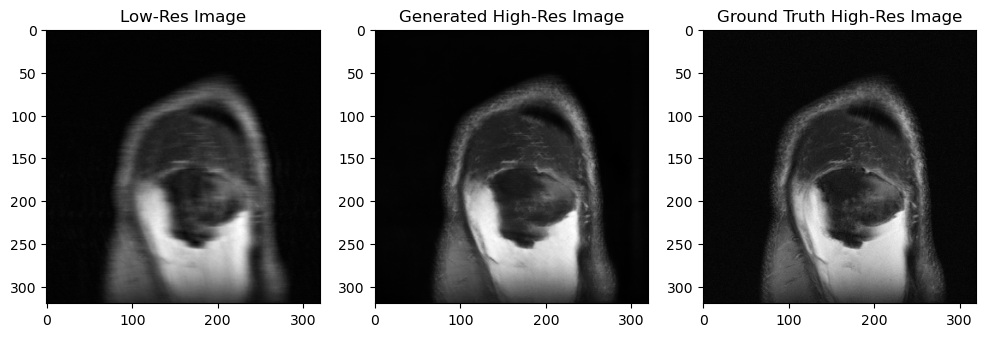

Validation: |          | 0/? [00:00<?, ?it/s]

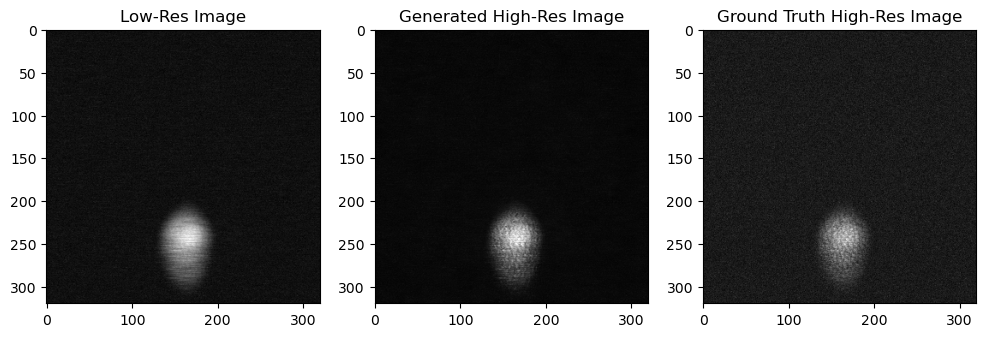

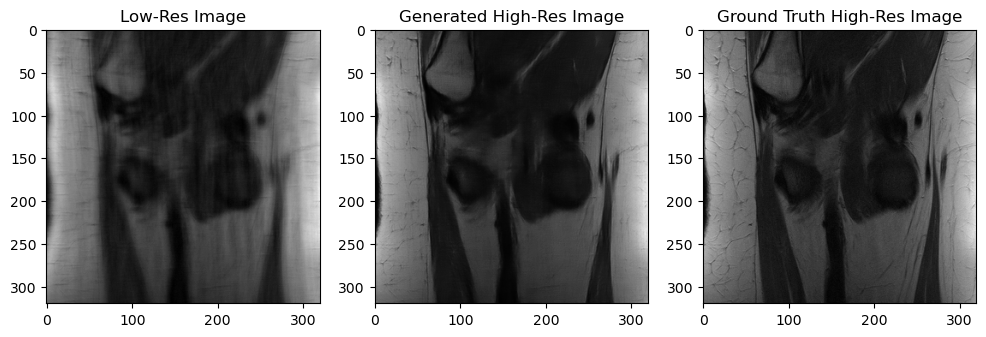

Validation: |          | 0/? [00:00<?, ?it/s]

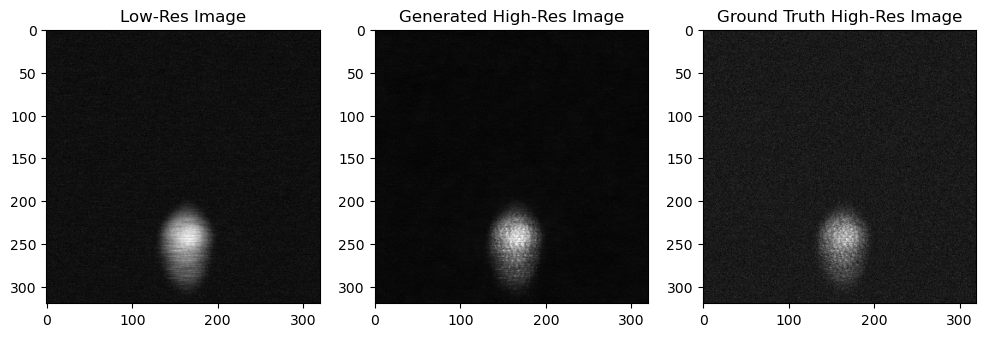

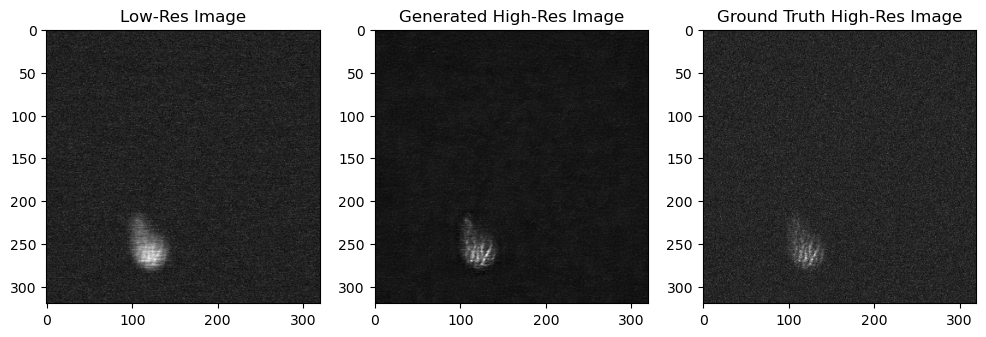

Validation: |          | 0/? [00:00<?, ?it/s]

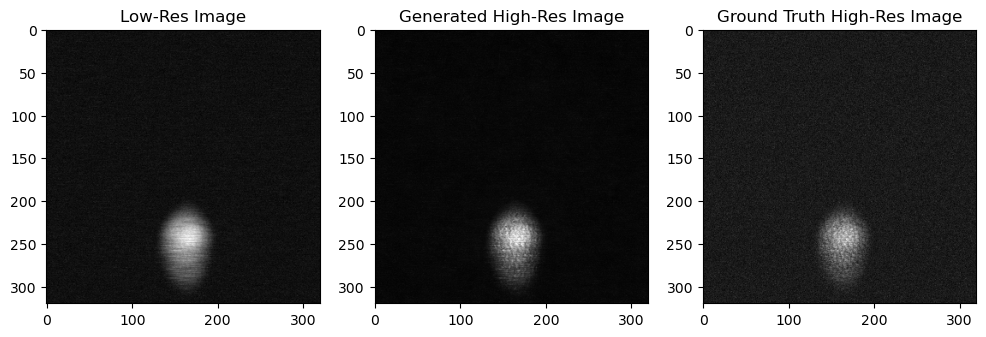

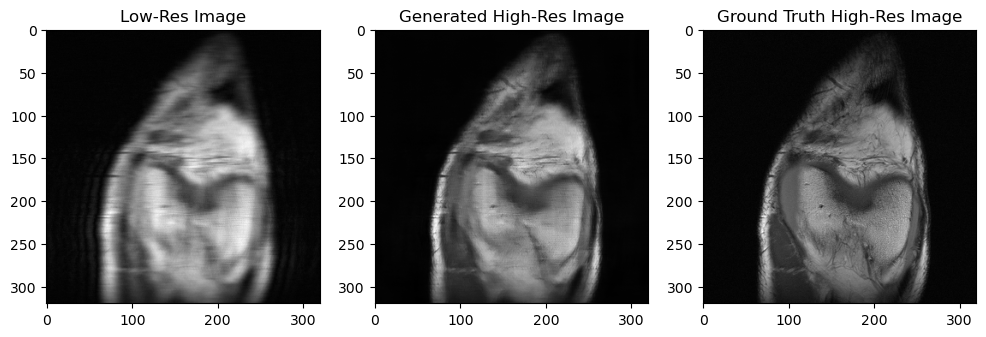

Validation: |          | 0/? [00:00<?, ?it/s]

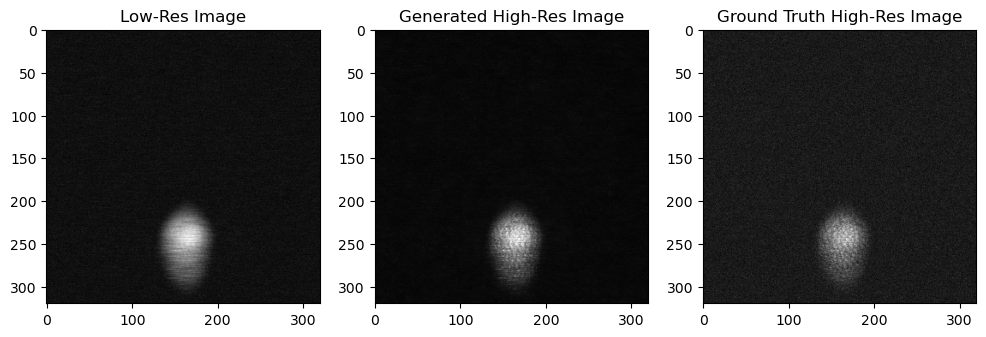

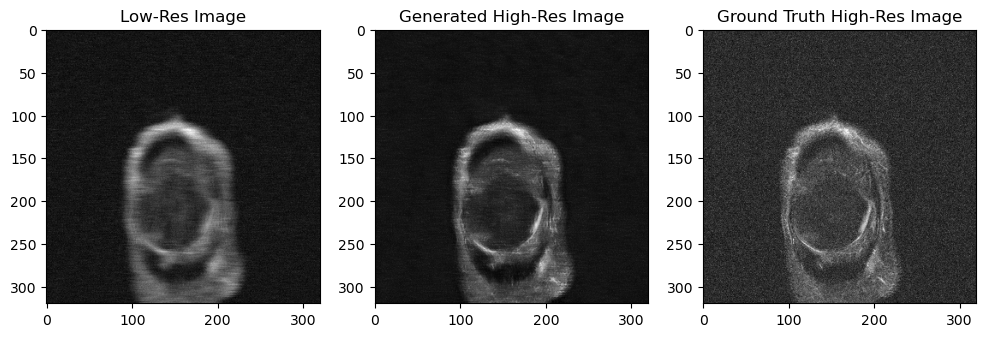

Validation: |          | 0/? [00:00<?, ?it/s]

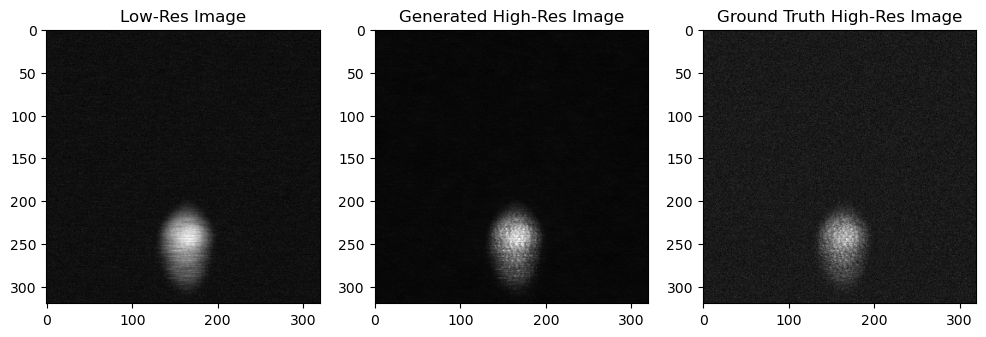

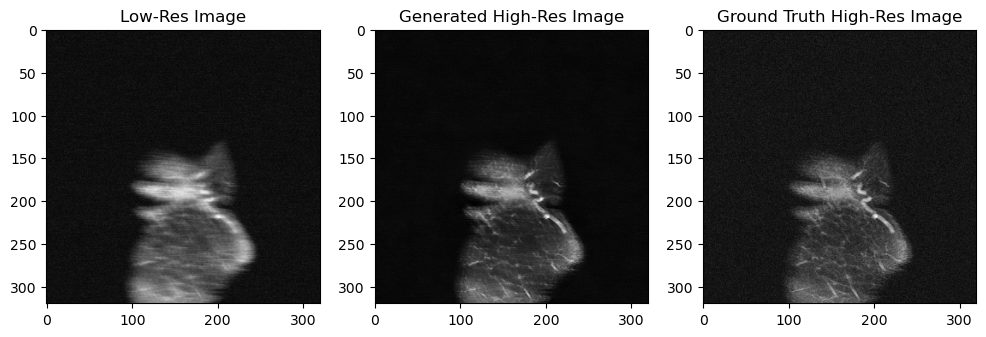

Validation: |          | 0/? [00:00<?, ?it/s]

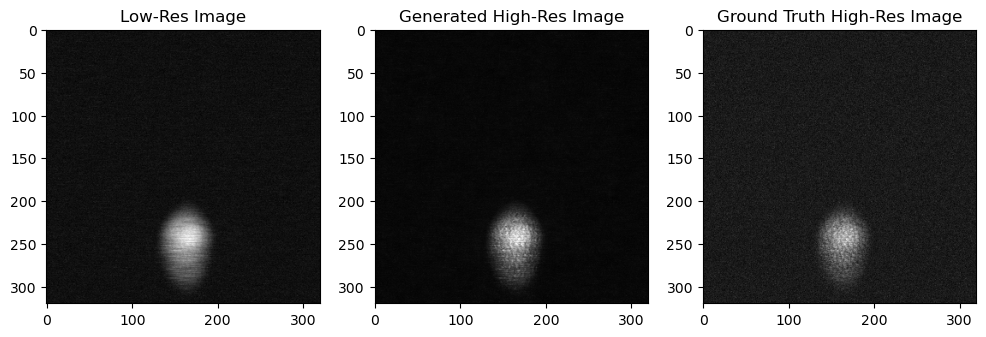

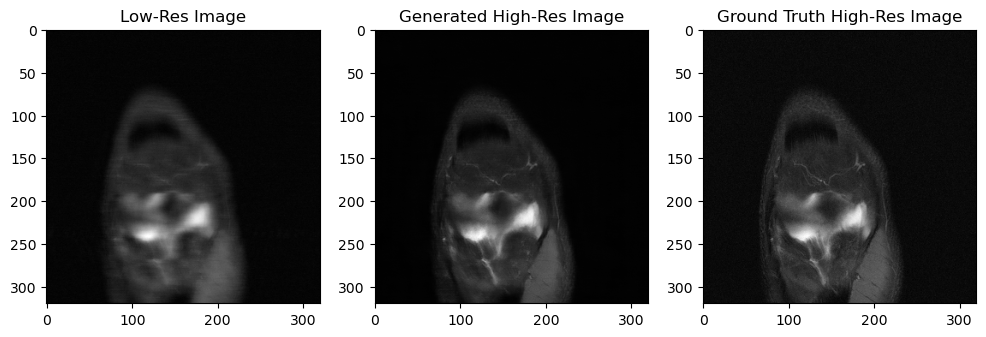

Validation: |          | 0/? [00:00<?, ?it/s]

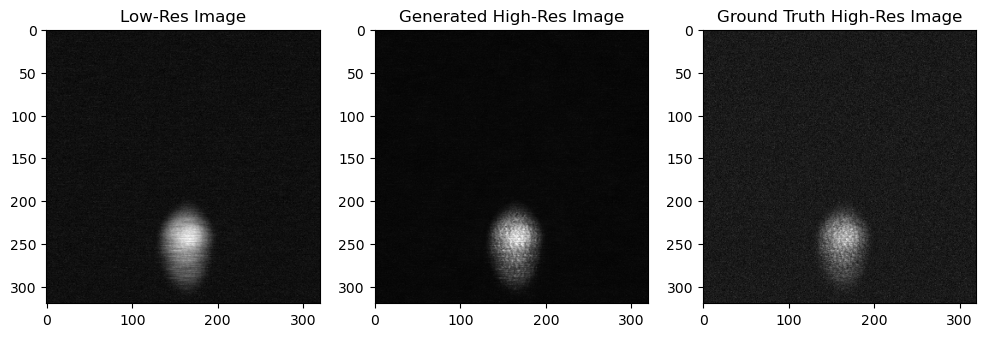

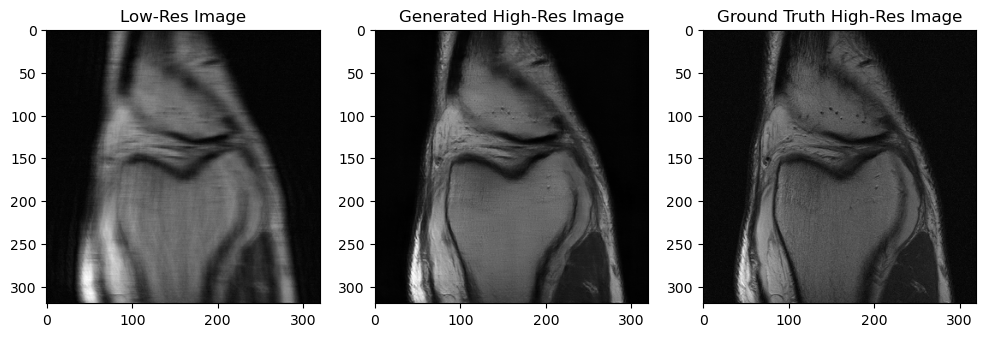

Validation: |          | 0/? [00:00<?, ?it/s]

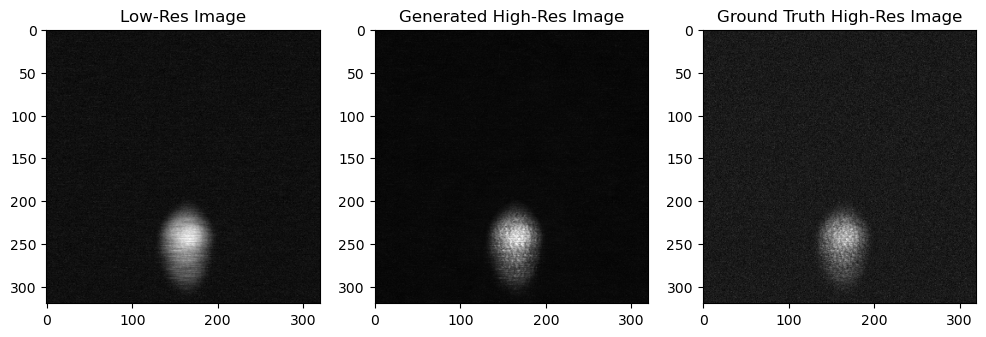

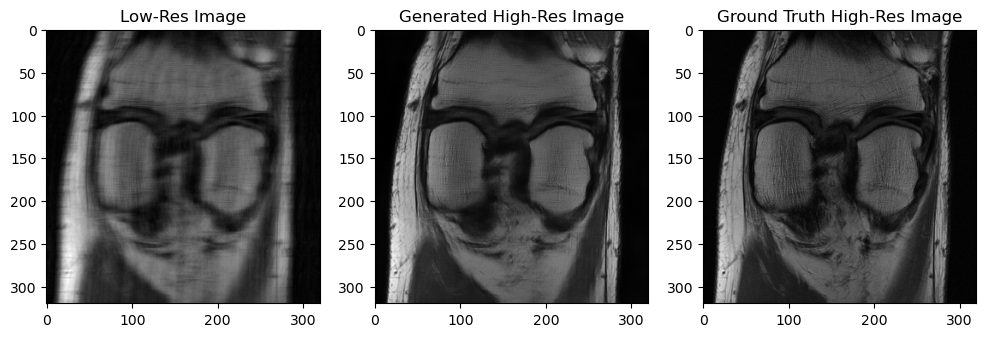

Validation: |          | 0/? [00:00<?, ?it/s]

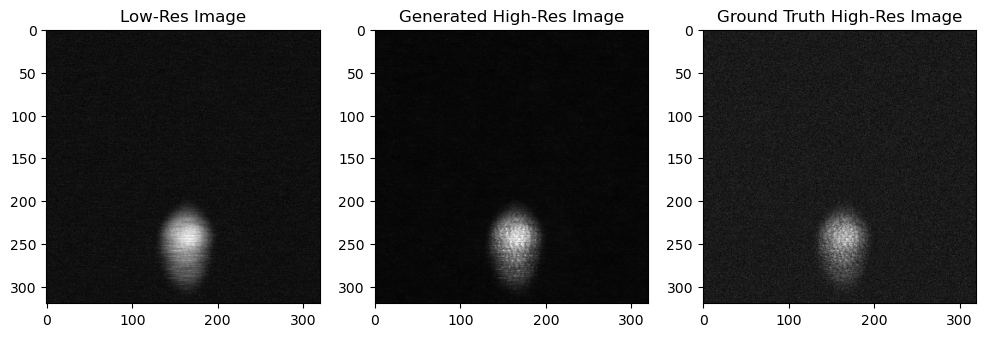

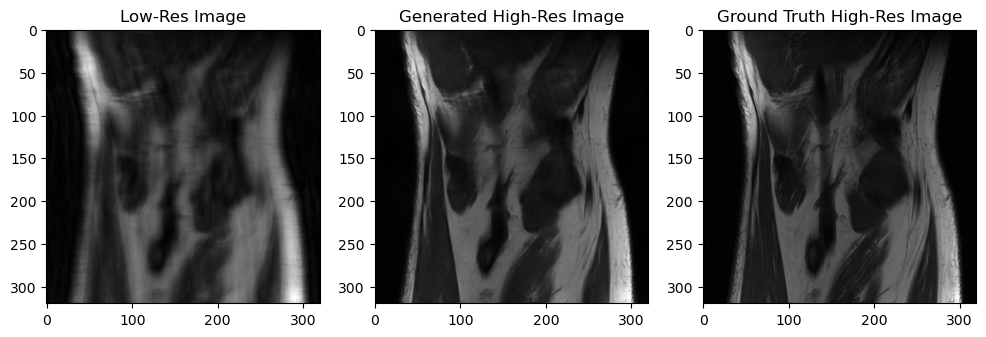

Validation: |          | 0/? [00:00<?, ?it/s]

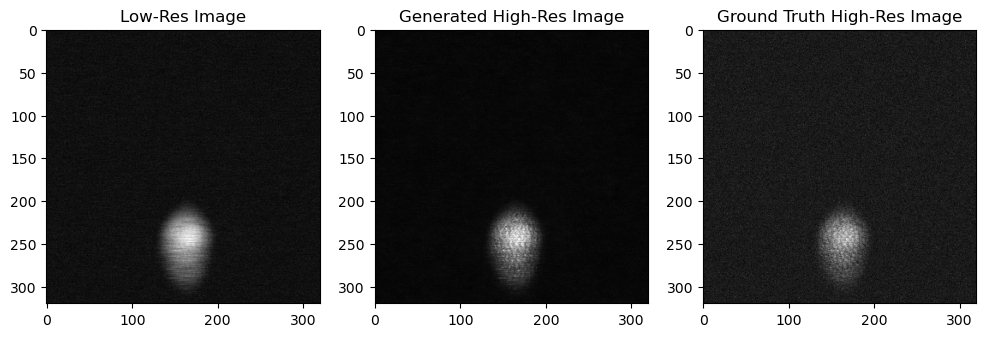

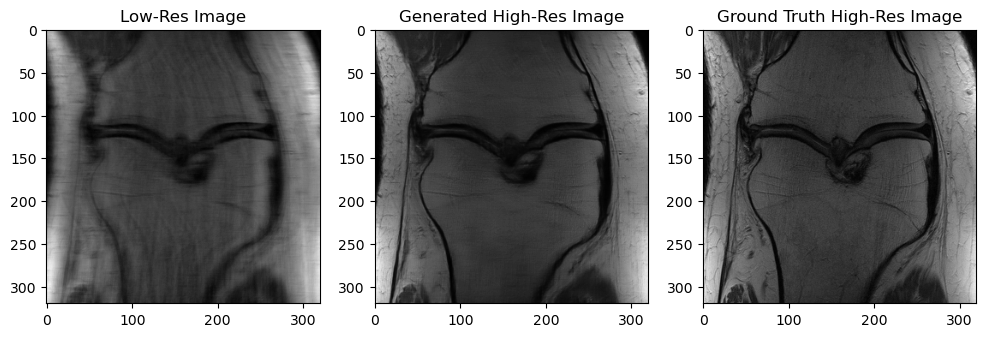

Validation: |          | 0/? [00:00<?, ?it/s]

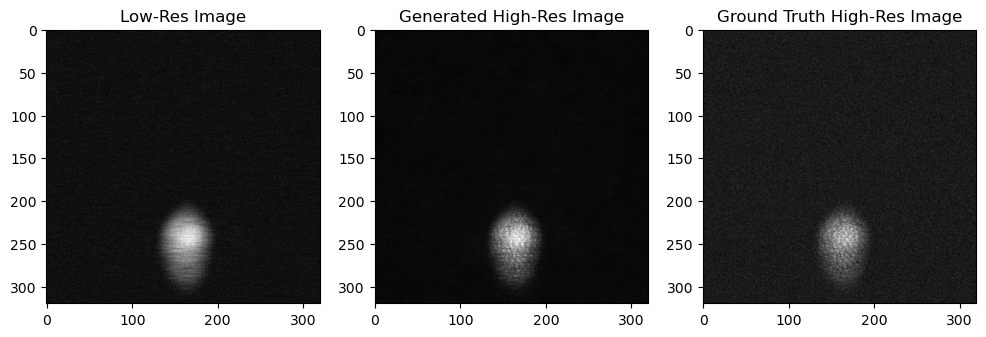

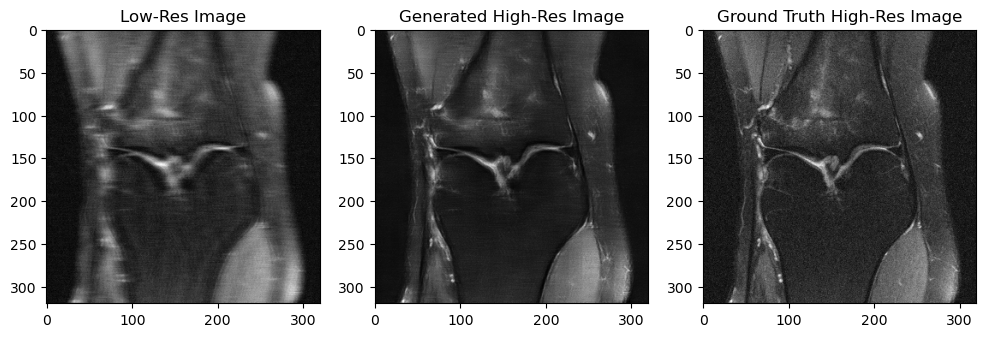

Validation: |          | 0/? [00:00<?, ?it/s]

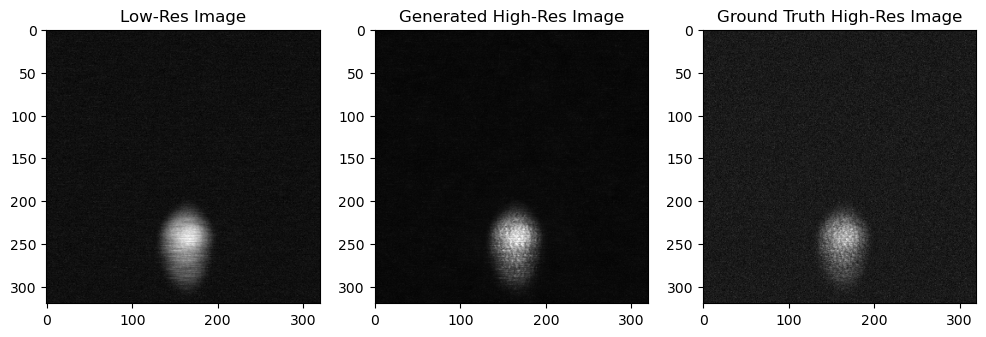

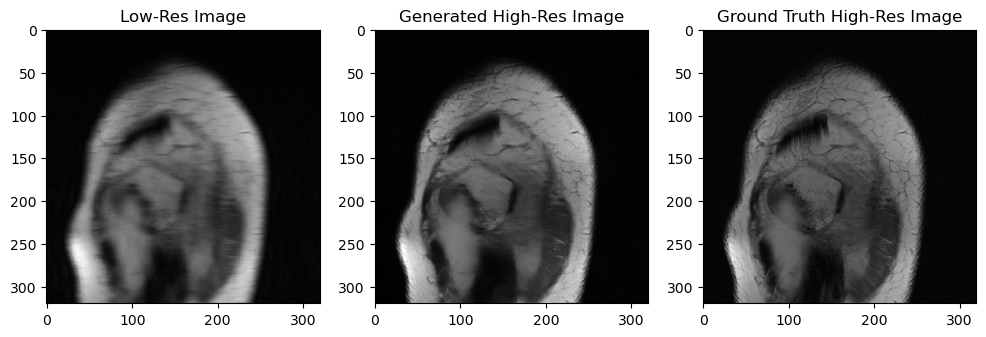

Validation: |          | 0/? [00:00<?, ?it/s]

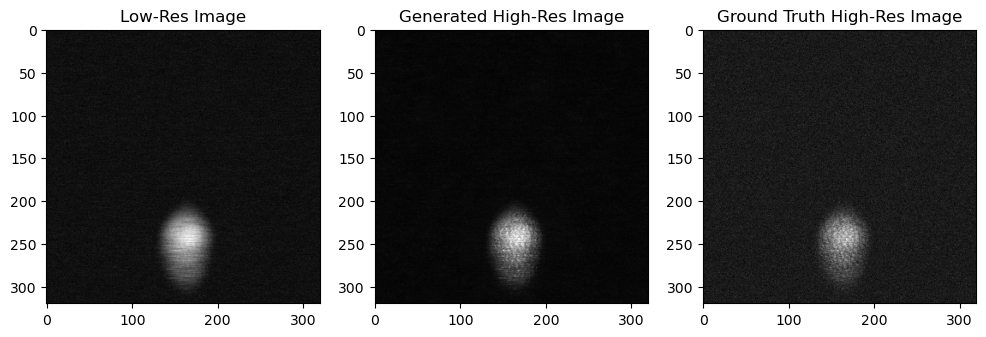

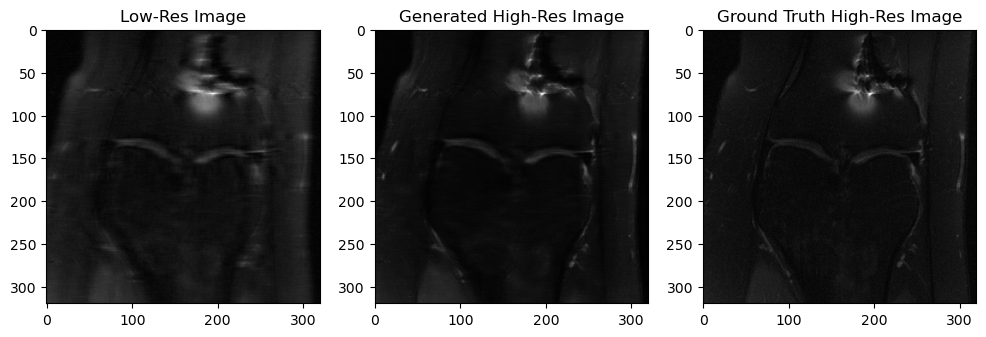

Validation: |          | 0/? [00:00<?, ?it/s]

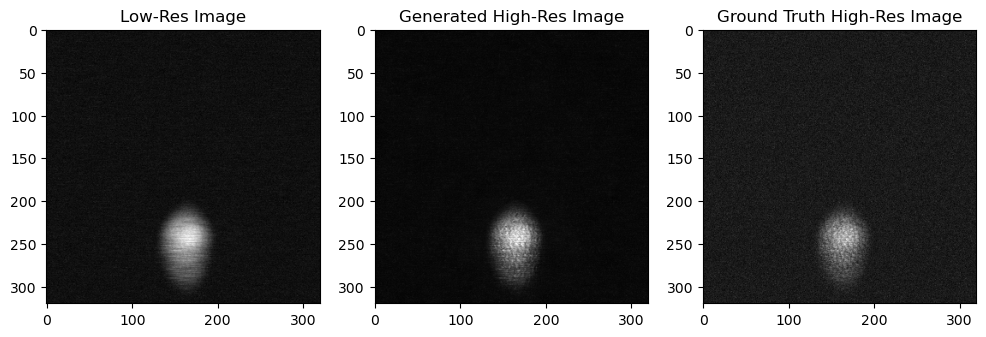

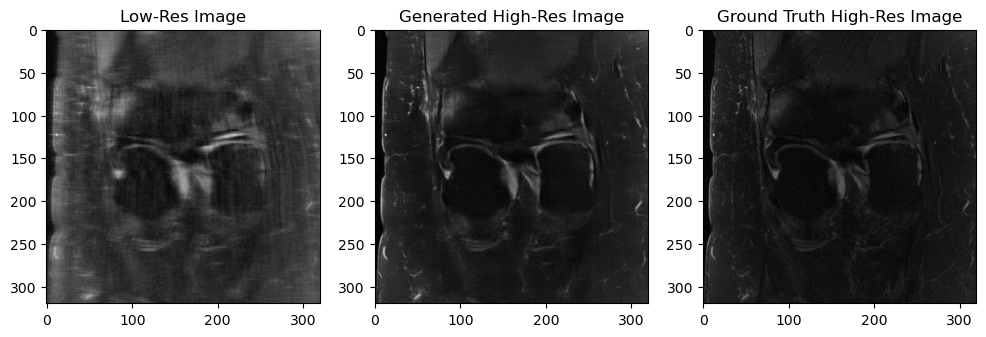

Validation: |          | 0/? [00:00<?, ?it/s]

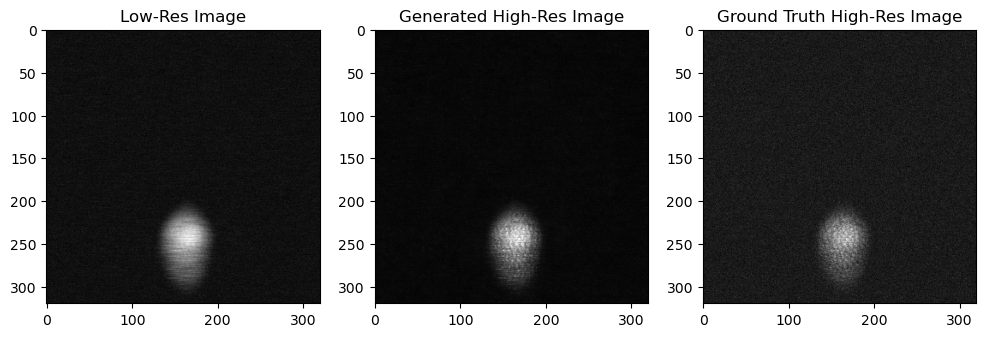

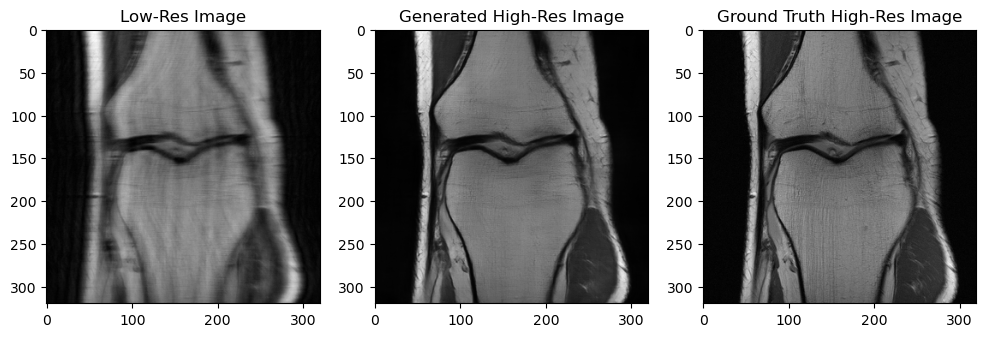

Validation: |          | 0/? [00:00<?, ?it/s]

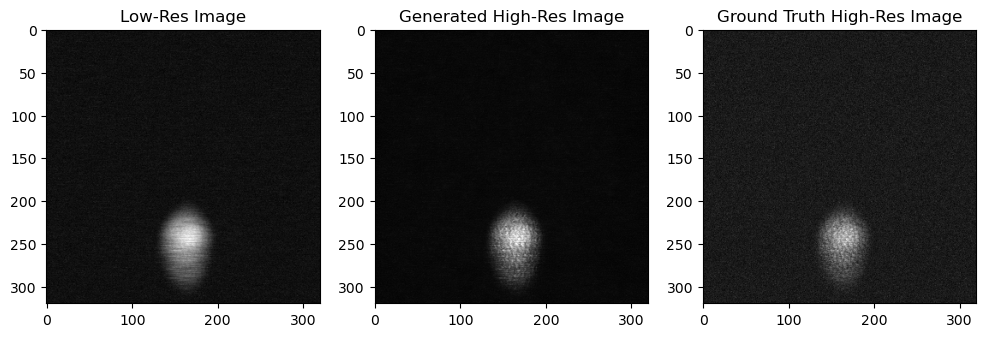

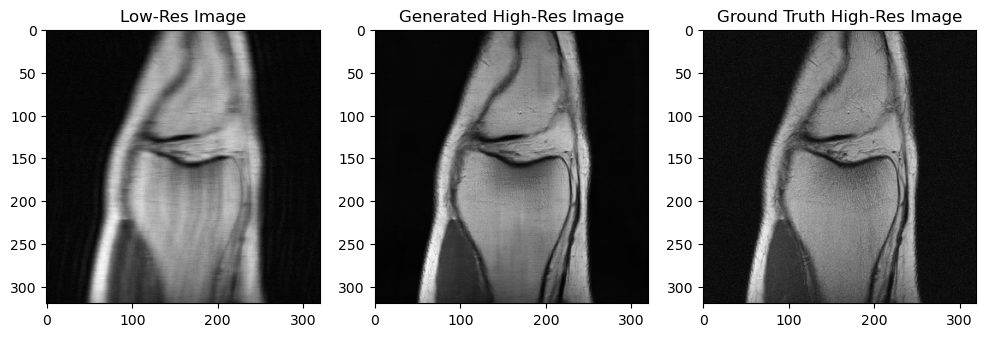

Validation: |          | 0/? [00:00<?, ?it/s]

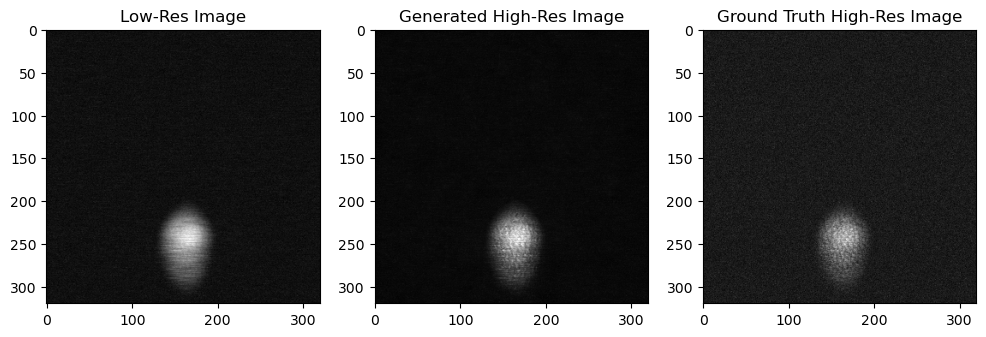

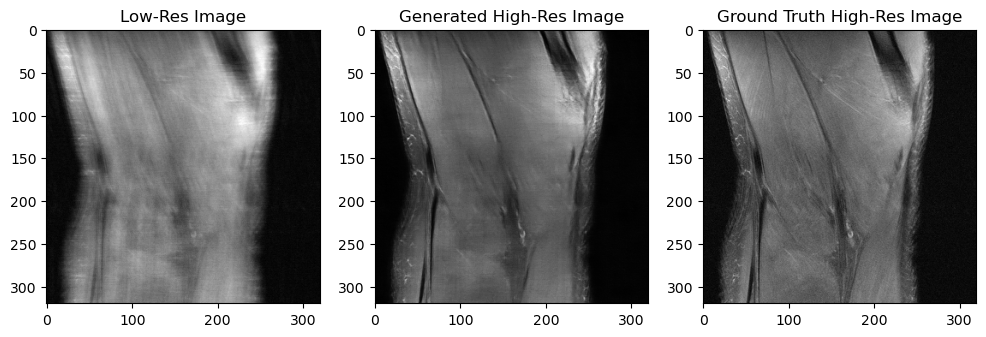

Validation: |          | 0/? [00:00<?, ?it/s]

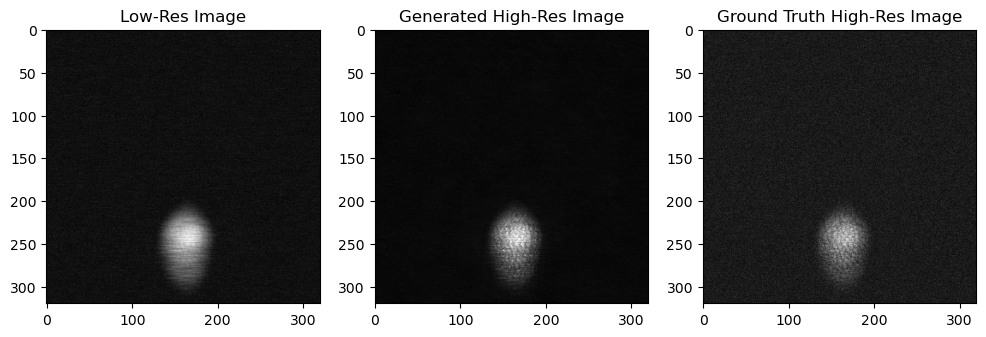

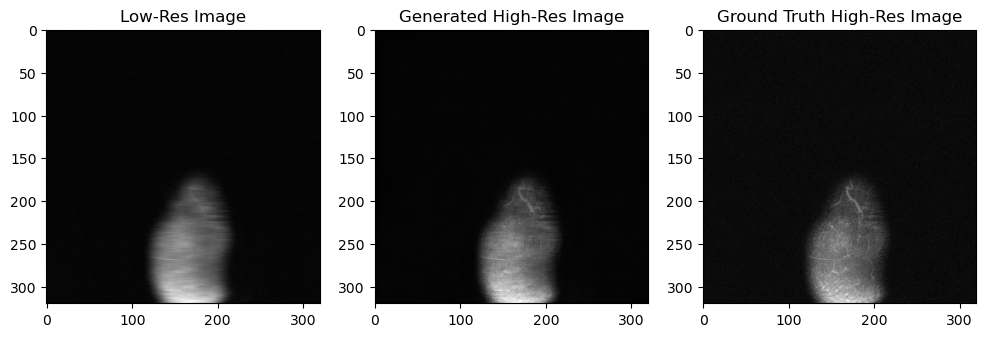

Validation: |          | 0/? [00:00<?, ?it/s]

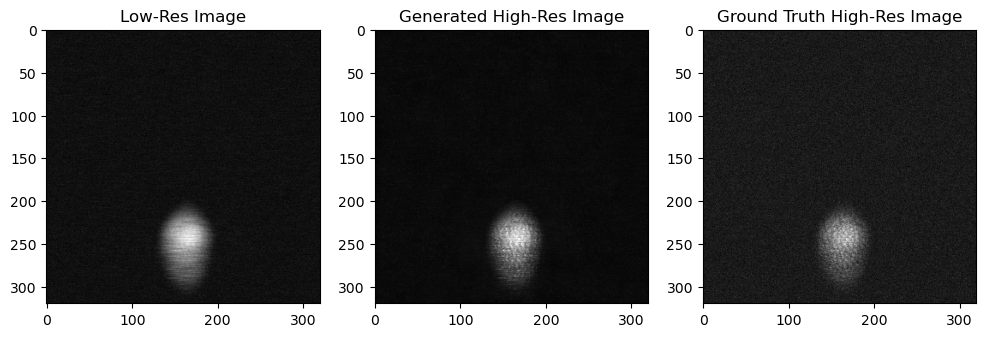

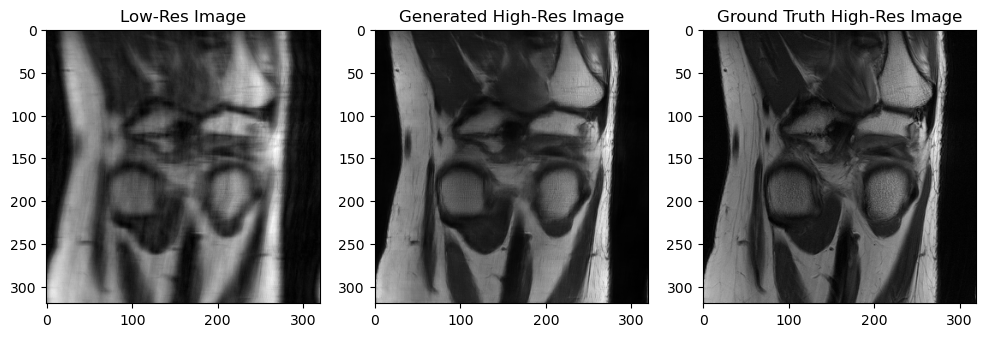

Validation: |          | 0/? [00:00<?, ?it/s]

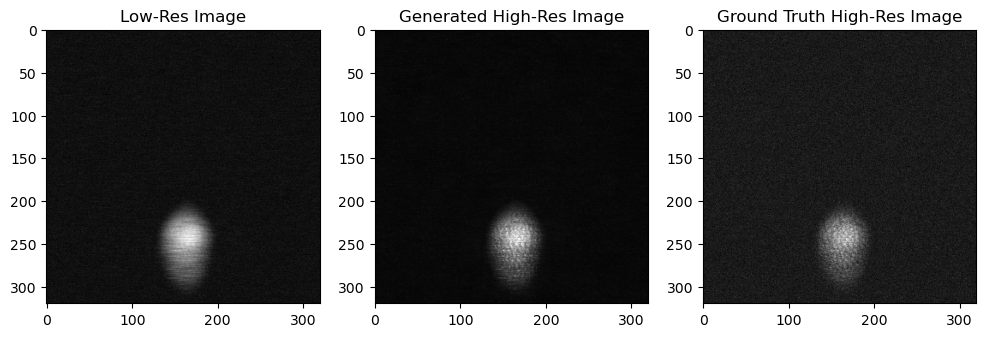

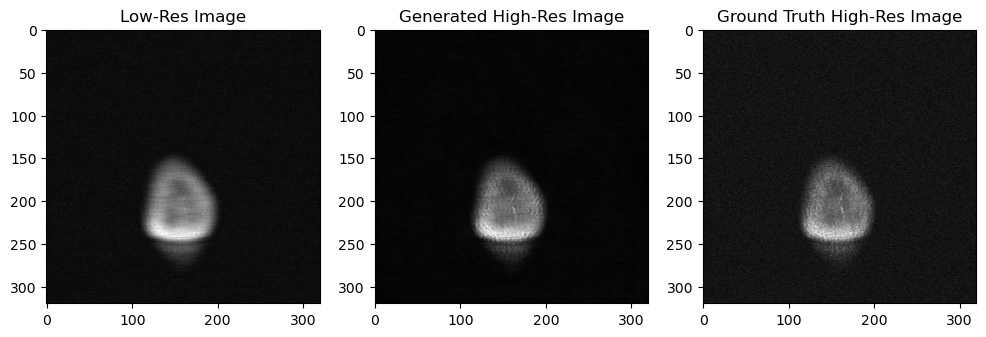

Validation: |          | 0/? [00:00<?, ?it/s]

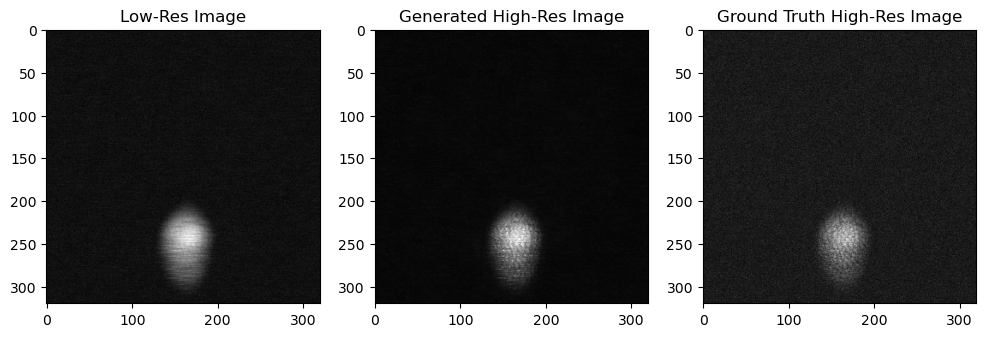

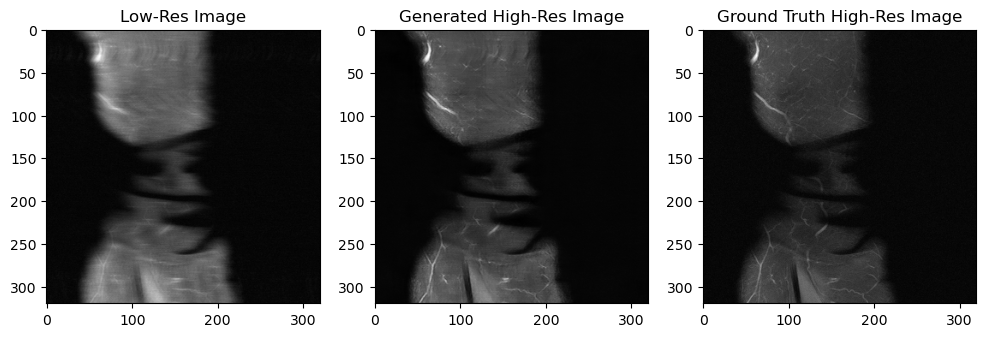

Validation: |          | 0/? [00:00<?, ?it/s]

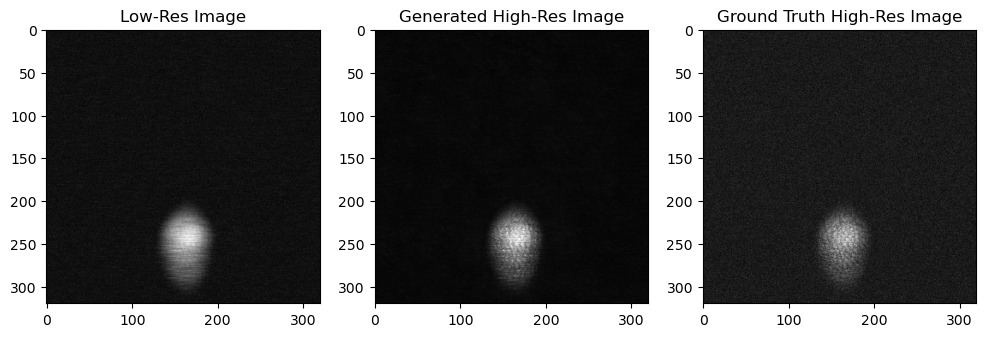

`Trainer.fit` stopped: `max_epochs=40` reached.


In [20]:
trainer.fit(model, train_loader, val_loader)

In [21]:
avg_train_loss= np.array(model.avg_train_loss)
print(avg_train_loss.shape)
avg_val_loss= np.array(model.avg_val_loss)
print(avg_val_loss.shape)
avg_train_ssim= np.array(model.avg_train_ssim)
print(avg_train_ssim.shape)
avg_val_ssim= np.array(model.avg_val_ssim)
print(avg_val_ssim.shape)
avg_train_psnr= np.array(model.avg_train_psnr)
print(avg_train_psnr.shape)
avg_val_psnr= np.array(model.avg_val_psnr)
print(avg_val_psnr.shape)

#Compute loss / SSIM / PSNR
for i in range(avg_train_loss.shape[0]):
    writer.add_scalars('train-val loss ', {'train_loss': avg_train_loss[i], 'val_loss': avg_val_loss[i+1]}, i)
    #Compute SSIM
    writer.add_scalars('train-val SSIM ', {'train_loss': avg_train_ssim[i], 'val_loss': avg_val_ssim[i+1]}, i)
    #Compute PSNR
    writer.add_scalars('train-val PSNR ', {'train_loss': avg_train_psnr[i], 'val_loss': avg_val_psnr[i+1]}, i)
writer.close()

(40,)
(41,)
(40,)
(41,)
(40,)
(41,)


In [22]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
x = torch.rand(8,1,320,320)
x = x.to(device)
model=model.to(device="cuda:0")
with torch.no_grad():
    writer.add_graph(model, x)

cuda:0


In [23]:
for name, item in model.named_parameters():
    writer.add_histogram(name, item, bins='auto')

In [24]:
for i in model.named_parameters():
    print(f"{i[0]} -> {i[1].device}")

model.e1.0.layers.0.weight -> cuda:0
model.e1.0.layers.0.bias -> cuda:0
model.e1.0.layers.1.weight -> cuda:0
model.e1.0.layers.1.bias -> cuda:0
model.e1.1.layers.0.weight -> cuda:0
model.e1.1.layers.0.bias -> cuda:0
model.e1.1.layers.1.weight -> cuda:0
model.e1.1.layers.1.bias -> cuda:0
model.e2.0.layers.0.weight -> cuda:0
model.e2.0.layers.0.bias -> cuda:0
model.e2.0.layers.1.weight -> cuda:0
model.e2.0.layers.1.bias -> cuda:0
model.e2.1.layers.0.weight -> cuda:0
model.e2.1.layers.0.bias -> cuda:0
model.e2.1.layers.1.weight -> cuda:0
model.e2.1.layers.1.bias -> cuda:0
model.e3.0.layers.0.weight -> cuda:0
model.e3.0.layers.0.bias -> cuda:0
model.e3.0.layers.1.weight -> cuda:0
model.e3.0.layers.1.bias -> cuda:0
model.e3.1.layers.0.weight -> cuda:0
model.e3.1.layers.0.bias -> cuda:0
model.e3.1.layers.1.weight -> cuda:0
model.e3.1.layers.1.bias -> cuda:0
model.e4.0.layers.0.weight -> cuda:0
model.e4.0.layers.0.bias -> cuda:0
model.e4.0.layers.1.weight -> cuda:0
model.e4.0.layers.1.bias ->

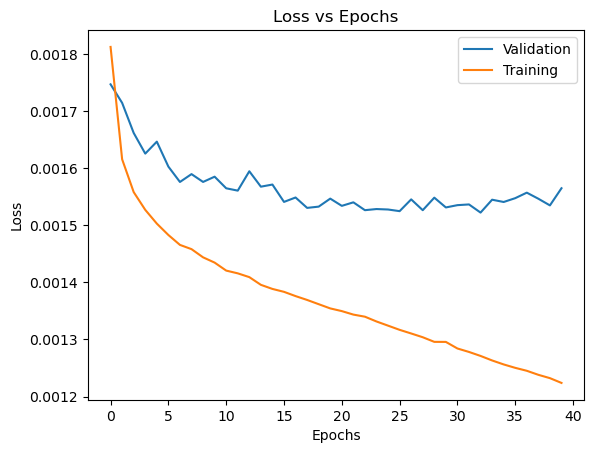

In [25]:
plt.plot(model.avg_val_loss[1:])
plt.plot(model.avg_train_loss)
plt.xlabel('Epochs'), plt.ylabel('Loss'), plt.title('Loss vs Epochs'), plt.legend(['Validation', 'Training'])
plt.show()

# Visualization of the results

In [26]:
model = SuperResolutionModel.load_from_checkpoint('logs/MultiCoil4Folds/UNET_BZ_32_LR_2e-4_Deco4/lightning_logs/version_0/checkpoints/epoch=21-step=23870.ckpt')

In [27]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model.eval();
model.to(device);

In [28]:
model

SuperResolutionModel(
  (model): UNet(
    (e1): Sequential(
      (0): ConvBlock(
        (layers): Sequential(
          (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
        )
      )
      (1): ConvBlock(
        (layers): Sequential(
          (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
        )
      )
    )
    (e2): Sequential(
      (0): ConvBlock(
        (layers): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
        )
      )
      (1): ConvBlock(
        (layers): Sequential(
          (0): Con

In [37]:
torch.cuda.empty_cache()

In [41]:
hr_images = []
hr_preds = []
lr_images = []

total = len(val_dataset)
for idx, (hr_image, lr_image) in enumerate(val_dataset, 1):
    lr_images.append(lr_image)
    lr_image = torch.tensor(lr_image).to(device).unsqueeze(0)
    with torch.no_grad():
        pred = model(lr_image)
    hr_preds.append(pred.cpu().numpy())
    hr_images.append(hr_image)
    
    # Print progress every few iterations
    if idx % 1000 == 0 or idx == total:
        print(f"Processed {idx}/{total} images")

lr_images = np.array(lr_images)
hr_preds = np.array(hr_preds)
hr_images = np.array(hr_images)


Processed 10/7135 images
Processed 20/7135 images
Processed 30/7135 images
Processed 40/7135 images
Processed 50/7135 images
Processed 60/7135 images
Processed 70/7135 images
Processed 80/7135 images
Processed 90/7135 images
Processed 100/7135 images
Processed 110/7135 images
Processed 120/7135 images
Processed 130/7135 images
Processed 140/7135 images
Processed 150/7135 images
Processed 160/7135 images
Processed 170/7135 images
Processed 180/7135 images
Processed 190/7135 images
Processed 200/7135 images
Processed 210/7135 images
Processed 220/7135 images
Processed 230/7135 images
Processed 240/7135 images
Processed 250/7135 images
Processed 260/7135 images
Processed 270/7135 images
Processed 280/7135 images
Processed 290/7135 images
Processed 300/7135 images
Processed 310/7135 images
Processed 320/7135 images
Processed 330/7135 images
Processed 340/7135 images
Processed 350/7135 images
Processed 360/7135 images
Processed 370/7135 images
Processed 380/7135 images
Processed 390/7135 im

In [42]:
lr_images.shape, hr_preds.shape, hr_images.shape

((7135, 1, 320, 320), (7135, 1, 1, 320, 320), (7135, 1, 320, 320))

In [43]:
print(hr_images.shape, hr_preds.shape, lr_images.shape)
preds_modificado = np.squeeze(hr_preds)
hr_modificado = np.squeeze(hr_images)
lr_modificado = np.squeeze(lr_images)
preds_modificado.shape, hr_modificado.shape, lr_modificado.shape

(7135, 1, 320, 320) (7135, 1, 1, 320, 320) (7135, 1, 320, 320)


((7135, 320, 320), (7135, 320, 320), (7135, 320, 320))

In [44]:
hr_images.min(), hr_images.max()

(0.0, 1.0)

In [45]:
hr_preds.min(), hr_preds.max()

(0.0005740246, 0.9747372)

In [46]:
model.loss_fn(torch.tensor(preds_modificado), torch.tensor(hr_modificado))

tensor(0.0014)

Text(0.5, 1.0, 'Input image')

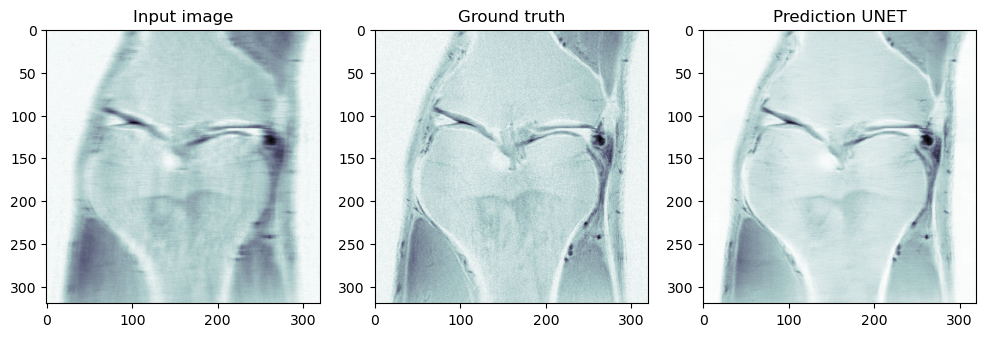

In [47]:
fig, ax = plt.subplots(1, 3, figsize=(12, 6))
ax[2].imshow(preds_modificado[5015], cmap="bone_r")
ax[2].set_title("Prediction UNET")
ax[1].imshow(hr_modificado[5015], cmap="bone_r")
ax[1].set_title("Ground truth")
ax[0].imshow(lr_modificado[5015], cmap="bone_r")
ax[0].set_title("Input image")

## Test

In [48]:
import h5py
import numpy as np
from Utils.NormStd import normalize, standardize
from Utils.Transform import transform_kspace_to_image

import torch
import matplotlib.pyplot as plt

In [54]:
fname_test = 'D:/Base de Datos/Single Coil/knee_singlecoil_test/file1000022.h5'

with h5py.File(fname_test, 'r') as f:
    ls = list(f.keys())
    print('List of datasets in this file: \n', ls)

    kspace = f.get('kspace')
    kspace = np.array(kspace)
    print('Shape of the array kspace: \n', kspace.shape)

    f.close()

List of datasets in this file: 
 ['ismrmrd_header', 'kspace', 'mask']
Shape of the array kspace: 
 (37, 640, 368)


In [55]:
def recortar_centro(imagen, alto_deseado=320, ancho_deseado=320):
    """
    Recorta el centro de una imagen.

    Args:
        imagen (numpy.ndarray): La imagen de entrada con dimensiones (Canales, Alto, Ancho).
        alto_deseado (int): Alto deseado para la imagen recortada.
        ancho_deseado (int): Ancho deseado para la imagen recortada.

    Returns:
        numpy.ndarray: La imagen recortada con dimensiones (Canales, alto_deseado, ancho_deseado).
    """
    alto_original, ancho_original = imagen.shape[1], imagen.shape[2]
    inicio_alto = (alto_original - alto_deseado) // 2
    inicio_ancho = (ancho_original - ancho_deseado) // 2
    fin_alto = inicio_alto + alto_deseado
    fin_ancho = inicio_ancho + ancho_deseado
    imagen_recortada = imagen[:, inicio_alto:fin_alto, inicio_ancho:fin_ancho]
    return imagen_recortada

In [56]:
imagespace = transform_kspace_to_image(kspace, dim=(1,2))
print(imagespace.shape)
imagespace_crop = recortar_centro(imagespace)
print(imagespace_crop.shape)

(37, 640, 368)
(37, 320, 320)


Text(0.5, 1.0, 'kspace')

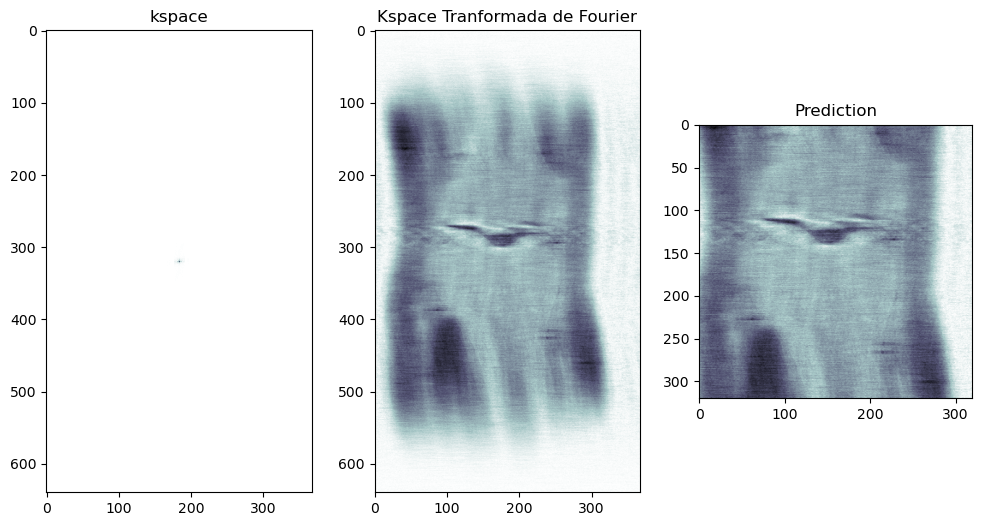

In [57]:
fig, ax = plt.subplots(1, 3, figsize=(12, 6))

ax[2].imshow(np.abs(imagespace_crop[19]), cmap="bone_r")
ax[2].set_title("Prediction")
ax[1].imshow(np.abs(imagespace[19]), cmap="bone_r")
ax[1].set_title("Kspace Tranformada de Fourier")
ax[0].imshow(np.abs(kspace[19]), cmap="bone_r")
ax[0].set_title("kspace")

In [58]:
imagespace_norm = normalize(np.abs(imagespace_crop))
imagespace_std = standardize(imagespace_norm[19])
print('Min  normalizada',imagespace_norm.min(), ' Max  normalizada',imagespace_norm.max())
print('Min  standarizada',imagespace_std.min(), '                Max  standarizada',imagespace_std.max())
print(imagespace_std.shape)

Min  normalizada -1.3863416784296199  Max  normalizada 5.553796004664583
Min  standarizada 0.0                 Max  standarizada 1.0
(320, 320)


In [59]:
imagespace_reshaped = np.expand_dims(imagespace_std, axis=0)
imagespace_tensor = torch.from_numpy(imagespace_reshaped)
imagespace_tensor = imagespace_tensor.float()
imagespace_tensor = imagespace_tensor.unsqueeze(0)
imagespace_tensor.shape

torch.Size([1, 1, 320, 320])

In [60]:
lr_image_re = torch.tensor(imagespace_tensor).to(device).squeeze(1)
lr_image_re.shape

C:\Users\garci\AppData\Local\Temp\ipykernel_11912\3804961158.py:1: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  lr_image_re = torch.tensor(imagespace_tensor).to(device).squeeze(1)


torch.Size([1, 320, 320])

In [61]:
lr_image_re.shape
imagespace_tensor = torch.tensor(lr_image_re).to(device).unsqueeze(0)
imagespace_tensor.shape

C:\Users\garci\AppData\Local\Temp\ipykernel_11912\2735755691.py:2: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  imagespace_tensor = torch.tensor(lr_image_re).to(device).unsqueeze(0)


torch.Size([1, 1, 320, 320])

In [62]:
# Ensure the model is also on the same device
model = model.to(device)
#imagespace_tensor = torch.tensor(lr_image_re).to(device).unsqueeze(0)
# Now, you can make predictions
with torch.no_grad():
    pred = model(imagespace_tensor)

In [63]:
preds_modificado = pred[0,0].cpu().numpy()
#preds_modificado1 = pred1[0,0].cpu().numpy()
preds_modificado.shape

(320, 320)

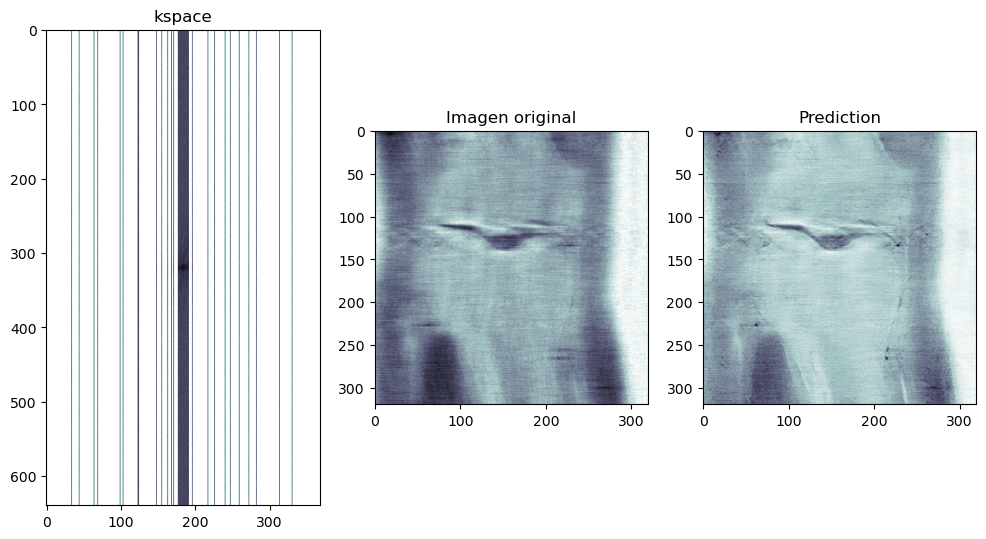

In [71]:
fig, ax = plt.subplots(1, 3, figsize=(12, 12))
ax[0].imshow(np.log(np.abs(kspace[19]+1e-12)), cmap="bone_r")
ax[0].set_title("kspace")
ax[2].imshow(preds_modificado, cmap="bone_r")
ax[2].set_title("Prediction")
ax[1].imshow(imagespace_std, cmap="bone_r")
ax[1].set_title("Imagen original")
# ax[3].imshow(preds_modificado1, cmap="bone_r")
# ax[3].set_title("Prediction1")
plt.show()